# *CoastSat*: example at Start Bay, United Kingdom


This example shows users how to extract time-series of shoreline change over the last 17+ years at their site of interest.
There are five main steps:
1. Retrieval of the satellite images of the region of interest from Google Earth Engine
2. Shoreline extraction at sub-pixel resolution
3. Intersection of the shorelines with cross-shore transects
4. Tidal correction 
5. Time-series post-processing
6. Validation against in situ surveys

This software is described in details in the following publications: 
- Shoreline detection:                      https://doi.org/10.1016/j.envsoft.2019.104528
- Accuracy assessment and applications:     https://doi.org/10.1016/j.coastaleng.2019.04.004
- Beach slope estimation:                   https://doi.org/10.1029/2020GL088365

## Initial settings

Refer to the **Installation** section of the README for instructions on how to install the Python packages necessary to run the software, including Google Earth Engine Python API. If that step has been completed correctly, the following packages should be imported without any problem.

In [1]:
%load_ext autoreload
%autoreload 2
import os
import numpy as np
import pickle
import warnings
warnings.filterwarnings("ignore")
import matplotlib
matplotlib.use('Qt5Agg')
import matplotlib.pyplot as plt
from matplotlib import gridspec
plt.ion()
import pandas as pd
from datetime import datetime, timedelta
from coastsat import SDS_download, SDS_preprocess, SDS_shoreline, SDS_tools, SDS_transects

from scipy import interpolate, stats

## 1. Retrieval of the images from GEE

Define the region of interest (`polygon`), the date range (`dates`) and the satellite missions (`sat_list`) from which you wish to retrieve the satellite images. The images will be cropped on the Google Earth Engine server and only the region of interest will be downloaded as a .tif file. The files will stored in the directory defined in `filepath`. 

Make sure the area of your ROI is smaller than 100 km2 (if larger split it into smaller ROIs).

The function `SDS_download.check_images_available(inputs)` will print the number of images available for your inputs. The Landsat images are divided in Tier 1 and Tier 2, only Tier 1 images can be used for time-series analysis.

For Landsat, users can also choose between Collection 1 and Collection 2 with the `collection` variable. Note that from 1st Jan 2022 newly acquired Landsat images are only available in Collection 2, with Landsat 9 only available in Collection 2, so it's preferred that you use Collection 2.

In [2]:
# region of interest (longitude, latitude)
polygon = [[[-3.60738,50.32860],
            [-3.58404,50.31280],
            [-3.62876,50.27294],
            [-3.63917,50.23051],
            [-3.63917,50.23051],
            [-3.65919,50.30171],
            [-3.60738,50.32860]]]
# it's recommended to convert the polygon to the smallest rectangle (sides parallel to coordinate axes)       
polygon = SDS_tools.smallest_rectangle(polygon)
# date range
dates = ['1999-01-01', '2024-01-01']
# satellite missions ['L5','L7','L8','L9','S2']
sat_list = ['S2']
# choose Landsat collection 'C01' or 'C02'
collection = 'C02'
# name of the site
sitename = 'STARTBAY'
# directory where the data will be stored
filepath = os.path.join(os.getcwd(), 'data')
# put all the inputs into a dictionnary
inputs = {'polygon': polygon, 'dates': dates, 'sat_list': sat_list, 'sitename': sitename, 'filepath':filepath,
         'landsat_collection': collection}

# before downloading the images, check how many images are available for your inputs
SDS_download.check_images_available(inputs);

Number of images available between 1999-01-01 and 2024-01-01:
- In Landsat Tier 1 & Sentinel-2 Level-1C:
     S2: 454 images
S2:There are 454 images available, 286 images already exist, 168 to download
  Total images available to download from Tier 1: 168 images


The function `SDS_download.retrieve_images(inputs)` retrives the satellite images from Google Earth Engine.

By default, only Landsat Tier 1 Top-of-Atmosphere and Sentinel-2 Level-1C products are downloaded. 

In case you need to access Tier 2 images for qualitative analysis, you need to set `inputs['include_T2'] = True` before calling `retrieve_images`.

In [3]:
# inputs['include_T2'] = True
metadata = SDS_download.retrieve_images(inputs)

Number of images available between 1999-01-01 and 2024-01-01:
- In Landsat Tier 1 & Sentinel-2 Level-1C:
     S2: 454 images
S2:There are 454 images available, 286 images already exist, 168 to download
  Total images available to download from Tier 1: 168 images


STARTBAY, S2: Transforming 0th image :   0%|                                                   | 0/168 [00:21<?, ?it/s]

skipping image '2015-11-12-11-24-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 97.17% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 2nd image :   1%|▍                                     | 2/168 [00:41<52:26, 18.95s/it]

skipping image '2015-11-12-11-24-29_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 97.17% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 3rd image :   2%|▋                                     | 3/168 [00:51<40:42, 14.80s/it]

skipping image '2015-12-22-11-33-32_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 4th image :   2%|▉                                     | 4/168 [01:00<34:32, 12.64s/it]

skipping image '2015-12-22-11-33-32_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 5th image :   3%|█▏                                    | 5/168 [01:10<31:14, 11.50s/it]

skipping image '2016-01-21-11-30-08_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 6th image :   4%|█▎                                    | 6/168 [01:20<29:27, 10.91s/it]

skipping image '2016-01-21-11-30-08_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 7th image :   4%|█▌                                    | 7/168 [01:30<28:59, 10.81s/it]

skipping image '2016-04-20-11-22-42_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 8th image :   5%|█▊                                    | 8/168 [01:39<27:13, 10.21s/it]

skipping image '2016-04-20-11-22-42_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 9th image :   5%|██                                    | 9/168 [01:50<27:10, 10.26s/it]

skipping image '2016-04-30-11-26-39_S2_STARTBAY_ms.tif' due to cloud and no data cover 98.21% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 10th image :   6%|██▏                                 | 10/168 [01:59<26:30, 10.06s/it]

skipping image '2016-04-30-11-26-39_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 98.21% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 10th image :   6%|██                                | 10/168 [02:00<26:30, 10.06s/it]
STARTBAY, S2: remove duplicates for 10th image :   6%|█▉                              | 10/168 [02:06<26:30, 10.06s/it]
STARTBAY, S2: Loading bands for 11th image :   7%|██▎                                 | 11/168 [02:06<24:08,  9.22s/it]

skipping image '2016-05-10-11-25-10_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 11th image :   7%|██▏                               | 11/168 [02:09<24:08,  9.22s/it]
STARTBAY, S2: remove duplicates for 11th image :   7%|██                              | 11/168 [02:16<24:08,  9.22s/it]
STARTBAY, S2: Loading bands for 12th image :   7%|██▌                                 | 12/168 [02:17<24:46,  9.53s/it]

skipping image '2016-05-10-11-25-10_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 12th image :   7%|██▍                               | 12/168 [02:18<24:46,  9.53s/it]
STARTBAY, S2: remove duplicates for 12th image :   7%|██▎                             | 12/168 [02:25<24:46,  9.53s/it]
STARTBAY, S2: Loading bands for 13th image :   8%|██▊                                 | 13/168 [02:26<24:26,  9.46s/it]

skipping image '2016-05-30-11-21-19_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 13th image :   8%|██▋                               | 13/168 [02:28<24:26,  9.46s/it]
STARTBAY, S2: remove duplicates for 13th image :   8%|██▍                             | 13/168 [02:35<24:26,  9.46s/it]
STARTBAY, S2: Loading bands for 14th image :   8%|███                                 | 14/168 [02:36<24:44,  9.64s/it]

skipping image '2016-05-30-11-21-19_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 14th image :   8%|██▊                               | 14/168 [02:37<24:44,  9.64s/it]
STARTBAY, S2: remove duplicates for 14th image :   8%|██▋                             | 14/168 [02:45<24:44,  9.64s/it]
STARTBAY, S2: Loading bands for 15th image :   9%|███▏                                | 15/168 [02:45<24:24,  9.57s/it]

skipping image '2016-07-09-11-24-03_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 15th image :   9%|███                               | 15/168 [02:47<24:24,  9.57s/it]
STARTBAY, S2: remove duplicates for 15th image :   9%|██▊                             | 15/168 [02:58<24:24,  9.57s/it]
STARTBAY, S2: Loading bands for 16th image :  10%|███▍                                | 16/168 [02:58<26:35, 10.49s/it]

skipping image '2016-07-09-11-24-03_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 17th image :  10%|███▋                                | 17/168 [03:09<26:31, 10.54s/it]

skipping image '2016-07-29-11-24-07_S2_STARTBAY_ms.tif' due to cloud and no data cover 96.81% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 18th image :  11%|███▊                                | 18/168 [03:19<26:31, 10.61s/it]

skipping image '2016-07-29-11-24-07_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 96.81% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 19th image :  11%|████                                | 19/168 [03:28<24:46,  9.97s/it]

skipping image '2016-08-18-11-25-54_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 20th image :  12%|████▎                               | 20/168 [03:36<23:21,  9.47s/it]

skipping image '2016-08-18-11-25-54_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 21st image :  12%|████▌                               | 21/168 [03:44<21:58,  8.97s/it]

skipping image '2016-08-28-11-21-14_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 22nd image :  13%|████▋                               | 22/168 [03:53<21:58,  9.03s/it]

skipping image '2016-08-28-11-21-14_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 23rd image :  14%|████▉                               | 23/168 [04:04<23:06,  9.56s/it]

skipping image '2016-09-07-11-26-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 97.62% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 24th image :  14%|█████▏                              | 24/168 [04:14<23:16,  9.70s/it]

skipping image '2016-09-07-11-26-22_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 97.62% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 25th image :  15%|█████▎                              | 25/168 [04:50<41:41, 17.50s/it]

skipping image '2016-10-27-11-23-49_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 26th image :  15%|█████▌                              | 26/168 [04:58<34:57, 14.77s/it]

skipping image '2016-10-27-11-23-49_S2_STARTBAY_ms_dup1.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 27th image :  16%|█████▊                              | 27/168 [05:09<31:45, 13.51s/it]

skipping image '2017-02-14-11-21-42_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 28th image :  17%|██████                              | 28/168 [05:18<28:26, 12.19s/it]

skipping image '2017-03-06-11-21-06_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 29th image :  17%|██████▏                             | 29/168 [05:26<25:23, 10.96s/it]

skipping image '2017-06-04-11-21-15_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 30th image :  18%|██████▍                             | 30/168 [05:34<23:11, 10.08s/it]

skipping image '2017-07-19-11-25-11_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 31st image :  18%|██████▋                             | 31/168 [05:41<21:13,  9.29s/it]

skipping image '2017-08-13-11-24-33_S2_STARTBAY_ms.tif' due to cloud and no data cover 98.80% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 32nd image :  19%|██████▊                             | 32/168 [05:45<17:26,  7.70s/it]

skipping image '2017-08-15-11-09-35_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 33rd image :  20%|███████                             | 33/168 [05:53<17:30,  7.78s/it]

skipping image '2017-08-23-11-21-14_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 34th image :  20%|███████▎                            | 34/168 [05:57<14:21,  6.43s/it]

skipping image '2017-09-09-11-12-17_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 35th image :  21%|███████▌                            | 35/168 [06:01<12:36,  5.69s/it]

skipping image '2017-09-19-11-09-17_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 36th image :  21%|███████▋                            | 36/168 [06:10<15:07,  6.87s/it]

skipping image '2017-10-07-11-20-58_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 37th image :  22%|███████▉                            | 37/168 [06:20<16:44,  7.67s/it]

skipping image '2017-11-06-11-22-32_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 38th image :  23%|████████▏                           | 38/168 [06:29<17:35,  8.12s/it]

skipping image '2017-12-11-11-24-47_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 39th image :  23%|████████▎                           | 39/168 [06:36<16:46,  7.80s/it]

skipping image '2018-01-20-11-23-56_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 40th image :  24%|████████▌                           | 40/168 [06:44<16:33,  7.76s/it]

skipping image '2018-02-24-11-22-28_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 41st image :  24%|████████▊                           | 41/168 [06:52<16:57,  8.01s/it]

skipping image '2018-03-06-11-22-41_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 42nd image :  25%|█████████                           | 42/168 [07:00<16:41,  7.95s/it]

skipping image '2018-03-16-11-25-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 43rd image :  26%|█████████▏                          | 43/168 [07:07<15:42,  7.54s/it]

skipping image '2018-03-31-11-21-13_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 44th image :  26%|█████████▍                          | 44/168 [07:14<15:30,  7.51s/it]

skipping image '2018-04-10-11-21-50_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 45th image :  27%|█████████▋                          | 45/168 [07:24<16:48,  8.20s/it]

skipping image '2018-04-15-11-26-36_S2_STARTBAY_ms.tif' due to cloud and no data cover 97.86% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 46th image :  27%|█████████▊                          | 46/168 [07:32<16:33,  8.14s/it]

skipping image '2018-04-30-11-21-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 47th image :  28%|██████████                          | 47/168 [07:40<16:20,  8.10s/it]

skipping image '2018-05-20-11-25-43_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 48th image :  29%|██████████▎                         | 48/168 [07:48<16:07,  8.06s/it]


skipping image '2018-06-04-11-24-46_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%


STARTBAY, S2: Loading bands for 49th image :  29%|██████████▌                         | 49/168 [07:55<15:11,  7.66s/it]

skipping image '2018-06-09-11-24-13_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 50th image :  30%|██████████▋                         | 50/168 [08:02<14:45,  7.51s/it]

skipping image '2018-06-14-11-21-12_S2_STARTBAY_ms.tif' due to cloud and no data cover 95.10% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 51st image :  30%|██████████▉                         | 51/168 [08:10<14:54,  7.65s/it]

skipping image '2018-06-19-11-26-02_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 52nd image :  31%|███████████▏                        | 52/168 [08:18<14:56,  7.73s/it]

skipping image '2018-07-04-11-21-12_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 53rd image :  32%|███████████▎                        | 53/168 [08:26<15:02,  7.85s/it]

skipping image '2018-08-08-11-25-58_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.62% exceeds threshold of 95.00%



STARTBAY, S2: Transforming 53rd image :  32%|████████████▉                            | 53/168 [08:33<15:02,  7.85s/it]

skipping image '2018-08-23-11-23-34_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 55th image :  33%|███████████▊                        | 55/168 [08:39<13:20,  7.08s/it]

skipping image '2018-09-02-11-21-04_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 56th image :  33%|████████████                        | 56/168 [08:43<11:40,  6.25s/it]

skipping image '2018-09-04-11-08-20_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 57th image :  34%|████████████▏                       | 57/168 [08:47<10:23,  5.62s/it]

skipping image '2018-09-14-11-10-41_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 58th image :  35%|████████████▍                       | 58/168 [08:57<12:15,  6.69s/it]

skipping image '2018-09-17-11-23-01_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 59th image :  35%|████████████▋                       | 59/168 [09:04<12:35,  6.94s/it]

skipping image '2018-09-22-11-21-06_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 60th image :  36%|████████████▊                       | 60/168 [09:12<13:10,  7.32s/it]

skipping image '2018-10-02-11-22-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 61st image :  36%|█████████████                       | 61/168 [09:22<14:13,  7.97s/it]

skipping image '2018-10-07-11-23-05_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 62nd image :  37%|█████████████▎                      | 62/168 [09:29<13:49,  7.83s/it]

skipping image '2018-11-06-11-27-17_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 63rd image :  38%|█████████████▌                      | 63/168 [09:37<13:31,  7.73s/it]

skipping image '2018-12-11-11-27-15_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 64th image :  38%|█████████████▋                      | 64/168 [09:45<13:41,  7.90s/it]

skipping image '2019-02-19-11-27-21_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 65th image :  39%|█████████████▉                      | 65/168 [09:53<13:35,  7.91s/it]

skipping image '2019-03-01-11-27-20_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.99% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 66th image :  39%|██████████████▏                     | 66/168 [10:02<13:59,  8.23s/it]

skipping image '2019-03-31-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 67th image :  40%|██████████████▎                     | 67/168 [10:11<13:58,  8.30s/it]

skipping image '2019-04-10-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 68th image :  40%|██████████████▌                     | 68/168 [10:19<13:50,  8.31s/it]

skipping image '2019-04-30-11-27-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 69th image :  41%|██████████████▊                     | 69/168 [10:26<13:17,  8.05s/it]

skipping image '2019-05-05-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.62% exceeds threshold of 95.00%



STARTBAY, S2: Transforming 69th image :  42%|█████████████████                        | 70/168 [10:34<12:56,  7.92s/it]

skipping image '2019-05-15-11-27-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 71st image :  42%|███████████████▏                    | 71/168 [10:41<12:33,  7.77s/it]

skipping image '2019-05-25-11-27-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 72nd image :  43%|███████████████▍                    | 72/168 [10:49<12:22,  7.74s/it]

skipping image '2019-06-19-11-27-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 73rd image :  43%|███████████████▋                    | 73/168 [10:56<12:02,  7.60s/it]

skipping image '2019-06-24-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.95% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 74th image :  44%|███████████████▊                    | 74/168 [11:04<11:43,  7.48s/it]

skipping image '2019-08-03-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 75th image :  45%|████████████████                    | 75/168 [11:12<11:57,  7.72s/it]

skipping image '2019-08-28-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 76th image :  45%|████████████████▎                   | 76/168 [11:19<11:38,  7.59s/it]

skipping image '2019-09-12-11-27-20_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 77th image :  46%|████████████████▌                   | 77/168 [11:28<12:04,  7.96s/it]

skipping image '2019-09-22-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.46% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 78th image :  46%|████████████████▋                   | 78/168 [11:35<11:46,  7.85s/it]

skipping image '2019-09-27-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 98.85% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 79th image :  47%|████████████████▉                   | 79/168 [11:43<11:22,  7.67s/it]

skipping image '2019-10-27-11-27-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 80th image :  48%|█████████████████▏                  | 80/168 [11:49<10:46,  7.34s/it]

skipping image '2019-11-01-11-27-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 81st image :  48%|█████████████████▎                  | 81/168 [11:57<10:49,  7.46s/it]

skipping image '2019-11-06-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 82nd image :  49%|█████████████████▌                  | 82/168 [12:04<10:40,  7.44s/it]

skipping image '2019-11-16-11-27-20_S2_STARTBAY_ms.tif' due to cloud and no data cover 96.95% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 83rd image :  49%|█████████████████▊                  | 83/168 [12:11<10:21,  7.31s/it]

skipping image '2019-12-06-11-27-16_S2_STARTBAY_ms.tif' due to cloud and no data cover 96.17% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 84th image :  50%|██████████████████                  | 84/168 [12:19<10:16,  7.34s/it]

skipping image '2019-12-16-11-27-16_S2_STARTBAY_ms.tif' due to cloud and no data cover 98.95% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 85th image :  51%|██████████████████▏                 | 85/168 [12:26<09:52,  7.14s/it]

skipping image '2019-12-21-11-27-16_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 86th image :  51%|██████████████████▍                 | 86/168 [12:33<09:51,  7.21s/it]

skipping image '2019-12-31-11-27-16_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 87th image :  52%|██████████████████▋                 | 87/168 [12:40<09:48,  7.26s/it]

skipping image '2020-01-30-11-27-14_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 88th image :  52%|██████████████████▊                 | 88/168 [12:47<09:35,  7.20s/it]

skipping image '2020-04-09-11-27-20_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 89th image :  53%|███████████████████                 | 89/168 [12:54<09:16,  7.05s/it]

skipping image '2020-04-24-11-27-16_S2_STARTBAY_ms.tif' due to cloud and no data cover 97.32% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 90th image :  54%|███████████████████▎                | 90/168 [13:01<09:14,  7.10s/it]

skipping image '2020-05-09-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 91st image :  54%|███████████████████▌                | 91/168 [13:04<07:31,  5.87s/it]

skipping image '2020-05-16-11-17-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 92nd image :  55%|███████████████████▋                | 92/168 [13:08<06:32,  5.16s/it]

skipping image '2020-05-26-11-17-30_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 93rd image :  55%|███████████████████▉                | 93/168 [13:11<05:48,  4.65s/it]

skipping image '2020-06-05-11-17-30_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 94th image :  56%|████████████████████▏               | 94/168 [13:19<07:01,  5.69s/it]

skipping image '2020-06-13-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 95th image :  57%|████████████████████▎               | 95/168 [13:26<07:15,  5.96s/it]

skipping image '2020-06-18-11-27-28_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 96th image :  57%|████████████████████▌               | 96/168 [13:34<07:47,  6.49s/it]

skipping image '2020-07-08-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 97th image :  58%|████████████████████▊               | 97/168 [13:42<08:12,  6.93s/it]

skipping image '2020-07-13-11-27-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 98th image :  58%|█████████████████████               | 98/168 [13:50<08:30,  7.30s/it]

skipping image '2020-07-18-11-27-27_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 99th image :  59%|█████████████████████▏              | 99/168 [13:58<08:34,  7.45s/it]

skipping image '2020-07-23-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Loading bands for 100th image :  60%|████████████████████▏             | 100/168 [14:06<08:51,  7.82s/it]

skipping image '2020-07-28-11-27-27_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.43% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 100th image :  60%|███████████████████             | 100/168 [14:07<08:51,  7.82s/it]
STARTBAY, S2: remove duplicates for 100th image :  60%|█████████████████▊            | 100/168 [14:12<08:51,  7.82s/it]
STARTBAY, S2: Loading bands for 101st image :  60%|████████████████████▍             | 101/168 [14:12<08:10,  7.33s/it]

skipping image '2020-08-07-11-27-28_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 101st image :  60%|███████████████████▏            | 101/168 [14:13<08:10,  7.33s/it]
STARTBAY, S2: remove duplicates for 101st image :  60%|██████████████████            | 101/168 [14:20<08:10,  7.33s/it]
STARTBAY, S2: Loading bands for 102nd image :  61%|████████████████████▋             | 102/168 [14:21<08:19,  7.57s/it]

skipping image '2020-09-06-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 102nd image :  61%|███████████████████▍            | 102/168 [14:22<08:19,  7.57s/it]
STARTBAY, S2: remove duplicates for 102nd image :  61%|██████████████████▏           | 102/168 [14:27<08:19,  7.57s/it]
STARTBAY, S2: Loading bands for 103rd image :  61%|████████████████████▊             | 103/168 [14:28<08:11,  7.56s/it]

skipping image '2020-09-11-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 103rd image :  61%|███████████████████▌            | 103/168 [14:29<08:11,  7.56s/it]
STARTBAY, S2: remove duplicates for 103rd image :  61%|██████████████████▍           | 103/168 [14:36<08:11,  7.56s/it]
STARTBAY, S2: Loading bands for 104th image :  62%|█████████████████████             | 104/168 [14:36<08:12,  7.70s/it]

skipping image '2020-10-01-11-27-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 104th image :  62%|███████████████████▊            | 104/168 [14:37<08:12,  7.70s/it]
STARTBAY, S2: remove duplicates for 104th image :  62%|██████████████████▌           | 104/168 [14:42<08:12,  7.70s/it]
STARTBAY, S2: Loading bands for 105th image :  62%|█████████████████████▎            | 105/168 [14:43<07:49,  7.44s/it]

skipping image '2020-10-11-11-27-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.98% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 105th image :  62%|████████████████████            | 105/168 [14:44<07:49,  7.44s/it]
STARTBAY, S2: remove duplicates for 105th image :  62%|██████████████████▊           | 105/168 [14:50<07:49,  7.44s/it]
STARTBAY, S2: Loading bands for 106th image :  63%|█████████████████████▍            | 106/168 [14:51<07:48,  7.56s/it]

skipping image '2020-10-16-11-27-27_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.58% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 106th image :  63%|████████████████████▏           | 106/168 [14:52<07:48,  7.56s/it]
STARTBAY, S2: remove duplicates for 106th image :  63%|██████████████████▉           | 106/168 [14:54<07:48,  7.56s/it]
STARTBAY, S2: Loading bands for 107th image :  64%|█████████████████████▋            | 107/168 [14:54<06:27,  6.36s/it]

skipping image '2020-10-23-11-17-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 107th image :  64%|████████████████████▍           | 107/168 [14:55<06:27,  6.36s/it]
STARTBAY, S2: remove duplicates for 107th image :  64%|███████████████████           | 107/168 [15:01<06:27,  6.36s/it]
STARTBAY, S2: Loading bands for 108th image :  64%|█████████████████████▊            | 108/168 [15:02<06:41,  6.70s/it]

skipping image '2020-10-31-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 95.61% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 108th image :  64%|████████████████████▌           | 108/168 [15:03<06:41,  6.70s/it]
STARTBAY, S2: remove duplicates for 108th image :  64%|███████████████████▎          | 108/168 [15:05<06:41,  6.70s/it]
STARTBAY, S2: Loading bands for 109th image :  65%|██████████████████████            | 109/168 [15:06<05:43,  5.82s/it]

skipping image '2020-11-02-11-17-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 109th image :  65%|████████████████████▊           | 109/168 [15:07<05:43,  5.82s/it]
STARTBAY, S2: remove duplicates for 109th image :  65%|███████████████████▍          | 109/168 [15:10<05:43,  5.82s/it]
STARTBAY, S2: Loading bands for 110th image :  65%|██████████████████████▎           | 110/168 [15:10<05:16,  5.46s/it]

skipping image '2020-11-12-11-17-28_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 110th image :  65%|████████████████████▉           | 110/168 [15:11<05:16,  5.46s/it]
STARTBAY, S2: remove duplicates for 110th image :  65%|███████████████████▋          | 110/168 [15:18<05:16,  5.46s/it]
STARTBAY, S2: Loading bands for 111th image :  66%|██████████████████████▍           | 111/168 [15:18<05:57,  6.28s/it]

skipping image '2020-11-15-11-27-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 111th image :  66%|█████████████████████▏          | 111/168 [15:19<05:57,  6.28s/it]
STARTBAY, S2: remove duplicates for 111th image :  66%|███████████████████▊          | 111/168 [15:25<05:57,  6.28s/it]
STARTBAY, S2: Loading bands for 112th image :  67%|██████████████████████▋           | 112/168 [15:26<06:13,  6.67s/it]

skipping image '2020-11-20-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 112th image :  67%|█████████████████████▎          | 112/168 [15:27<06:13,  6.67s/it]
STARTBAY, S2: remove duplicates for 112th image :  67%|████████████████████          | 112/168 [15:29<06:13,  6.67s/it]
STARTBAY, S2: Loading bands for 113th image :  67%|██████████████████████▊           | 113/168 [15:29<05:09,  5.62s/it]

skipping image '2020-11-22-11-17-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 113th image :  67%|█████████████████████▌          | 113/168 [15:30<05:09,  5.62s/it]
STARTBAY, S2: remove duplicates for 113th image :  67%|████████████████████▏         | 113/168 [15:36<05:09,  5.62s/it]
STARTBAY, S2: Loading bands for 114th image :  68%|███████████████████████           | 114/168 [15:37<05:39,  6.28s/it]

skipping image '2020-11-25-11-27-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 114th image :  68%|█████████████████████▋          | 114/168 [15:38<05:39,  6.28s/it]
STARTBAY, S2: remove duplicates for 114th image :  68%|████████████████████▎         | 114/168 [15:44<05:39,  6.28s/it]
STARTBAY, S2: Loading bands for 115th image :  68%|███████████████████████▎          | 115/168 [15:44<05:47,  6.56s/it]

skipping image '2020-12-05-11-27-20_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 115th image :  68%|█████████████████████▉          | 115/168 [15:45<05:47,  6.56s/it]
STARTBAY, S2: remove duplicates for 115th image :  68%|████████████████████▌         | 115/168 [15:50<05:47,  6.56s/it]
STARTBAY, S2: Transforming 115th image :  68%|██████████████████████████▋            | 115/168 [15:50<05:47,  6.56s/it]

skipping image '2020-12-10-11-27-19_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 116th image :  69%|██████████████████████          | 116/168 [15:52<05:46,  6.66s/it]
STARTBAY, S2: remove duplicates for 116th image :  69%|████████████████████▋         | 116/168 [15:58<05:46,  6.66s/it]
STARTBAY, S2: Loading bands for 117th image :  70%|███████████████████████▋          | 117/168 [15:59<05:52,  6.91s/it]

skipping image '2021-01-04-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 117th image :  70%|██████████████████████▎         | 117/168 [16:00<05:52,  6.91s/it]
STARTBAY, S2: remove duplicates for 117th image :  70%|████████████████████▉         | 117/168 [16:05<05:52,  6.91s/it]
STARTBAY, S2: Loading bands for 118th image :  70%|███████████████████████▉          | 118/168 [16:06<05:50,  7.00s/it]

skipping image '2021-01-09-11-27-21_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 118th image :  70%|██████████████████████▍         | 118/168 [16:07<05:50,  7.00s/it]
STARTBAY, S2: remove duplicates for 118th image :  70%|█████████████████████         | 118/168 [16:10<05:50,  7.00s/it]
STARTBAY, S2: Loading bands for 119th image :  71%|████████████████████████          | 119/168 [16:10<05:04,  6.21s/it]

skipping image '2021-01-21-11-17-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 119th image :  71%|██████████████████████▋         | 119/168 [16:11<05:04,  6.21s/it]
STARTBAY, S2: remove duplicates for 119th image :  71%|█████████████████████▎        | 119/168 [16:15<05:04,  6.21s/it]
STARTBAY, S2: Loading bands for 120th image :  71%|████████████████████████▎         | 120/168 [16:15<04:36,  5.77s/it]

skipping image '2021-02-05-11-17-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 120th image :  71%|██████████████████████▊         | 120/168 [16:16<04:36,  5.77s/it]
STARTBAY, S2: remove duplicates for 120th image :  71%|█████████████████████▍        | 120/168 [16:18<04:36,  5.77s/it]
STARTBAY, S2: Loading bands for 121st image :  72%|████████████████████████▍         | 121/168 [16:18<03:53,  4.96s/it]

skipping image '2021-02-15-11-17-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 121st image :  72%|███████████████████████         | 121/168 [16:19<03:53,  4.96s/it]
STARTBAY, S2: remove duplicates for 121st image :  72%|█████████████████████▌        | 121/168 [16:24<03:53,  4.96s/it]
STARTBAY, S2: Loading bands for 122nd image :  73%|████████████████████████▋         | 122/168 [16:25<04:13,  5.52s/it]

skipping image '2021-02-23-11-27-21_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 122nd image :  73%|███████████████████████▏        | 122/168 [16:26<04:13,  5.52s/it]
STARTBAY, S2: remove duplicates for 122nd image :  73%|█████████████████████▊        | 122/168 [16:32<04:13,  5.52s/it]
STARTBAY, S2: Loading bands for 123rd image :  73%|████████████████████████▉         | 123/168 [16:32<04:32,  6.06s/it]

skipping image '2021-03-05-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 123rd image :  73%|███████████████████████▍        | 123/168 [16:33<04:32,  6.06s/it]
STARTBAY, S2: remove duplicates for 123rd image :  73%|█████████████████████▉        | 123/168 [16:38<04:32,  6.06s/it]
STARTBAY, S2: Loading bands for 124th image :  74%|█████████████████████████         | 124/168 [16:39<04:37,  6.31s/it]

skipping image '2021-03-20-11-27-21_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 124th image :  74%|███████████████████████▌        | 124/168 [16:40<04:37,  6.31s/it]
STARTBAY, S2: remove duplicates for 124th image :  74%|██████████████████████▏       | 124/168 [16:46<04:37,  6.31s/it]
STARTBAY, S2: Loading bands for 125th image :  74%|█████████████████████████▎        | 125/168 [16:47<04:48,  6.71s/it]

skipping image '2021-03-25-11-27-20_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 125th image :  74%|███████████████████████▊        | 125/168 [16:48<04:48,  6.71s/it]
STARTBAY, S2: remove duplicates for 125th image :  74%|██████████████████████▎       | 125/168 [16:53<04:48,  6.71s/it]
STARTBAY, S2: Loading bands for 126th image :  75%|█████████████████████████▌        | 126/168 [16:54<04:45,  6.80s/it]

skipping image '2021-04-29-11-27-17_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.21% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 126th image :  75%|████████████████████████        | 126/168 [16:55<04:45,  6.80s/it]
STARTBAY, S2: remove duplicates for 126th image :  75%|██████████████████████▌       | 126/168 [17:00<04:45,  6.80s/it]
STARTBAY, S2: Loading bands for 127th image :  76%|█████████████████████████▋        | 127/168 [17:01<04:45,  6.95s/it]

skipping image '2021-05-29-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 127th image :  76%|████████████████████████▏       | 127/168 [17:02<04:45,  6.95s/it]
STARTBAY, S2: remove duplicates for 127th image :  76%|██████████████████████▋       | 127/168 [17:08<04:45,  6.95s/it]
STARTBAY, S2: Loading bands for 128th image :  76%|█████████████████████████▉        | 128/168 [17:08<04:43,  7.08s/it]

skipping image '2021-06-18-11-27-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 128th image :  76%|████████████████████████▍       | 128/168 [17:09<04:43,  7.08s/it]
STARTBAY, S2: remove duplicates for 128th image :  76%|██████████████████████▊       | 128/168 [17:16<04:43,  7.08s/it]
STARTBAY, S2: Loading bands for 129th image :  77%|██████████████████████████        | 129/168 [17:17<04:49,  7.43s/it]

skipping image '2021-07-08-11-27-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.98% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 129th image :  77%|████████████████████████▌       | 129/168 [17:18<04:49,  7.43s/it]
STARTBAY, S2: remove duplicates for 129th image :  77%|███████████████████████       | 129/168 [17:23<04:49,  7.43s/it]
STARTBAY, S2: Loading bands for 130th image :  77%|██████████████████████████▎       | 130/168 [17:24<04:37,  7.30s/it]

skipping image '2021-08-02-11-27-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 130th image :  77%|████████████████████████▊       | 130/168 [17:25<04:37,  7.30s/it]
STARTBAY, S2: remove duplicates for 130th image :  77%|███████████████████████▏      | 130/168 [17:30<04:37,  7.30s/it]
STARTBAY, S2: Loading bands for 131st image :  78%|██████████████████████████▌       | 131/168 [17:31<04:27,  7.22s/it]

skipping image '2021-08-12-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 131st image :  78%|████████████████████████▉       | 131/168 [17:32<04:27,  7.22s/it]
STARTBAY, S2: remove duplicates for 131st image :  78%|███████████████████████▍      | 131/168 [17:37<04:27,  7.22s/it]
STARTBAY, S2: Loading bands for 132nd image :  79%|██████████████████████████▋       | 132/168 [17:37<04:13,  7.05s/it]

skipping image '2021-09-01-11-27-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 132nd image :  79%|█████████████████████████▏      | 132/168 [17:38<04:13,  7.05s/it]
STARTBAY, S2: remove duplicates for 132nd image :  79%|███████████████████████▌      | 132/168 [17:44<04:13,  7.05s/it]
STARTBAY, S2: Loading bands for 133rd image :  79%|██████████████████████████▉       | 133/168 [17:44<04:04,  6.99s/it]

skipping image '2021-10-16-11-27-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 133rd image :  79%|█████████████████████████▎      | 133/168 [17:46<04:04,  6.99s/it]
STARTBAY, S2: remove duplicates for 133rd image :  79%|███████████████████████▊      | 133/168 [17:48<04:04,  6.99s/it]
STARTBAY, S2: Loading bands for 134th image :  80%|███████████████████████████       | 134/168 [17:49<03:31,  6.22s/it]

skipping image '2021-10-28-11-17-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 134th image :  80%|█████████████████████████▌      | 134/168 [17:50<03:31,  6.22s/it]
STARTBAY, S2: remove duplicates for 134th image :  80%|███████████████████████▉      | 134/168 [17:52<03:31,  6.22s/it]
STARTBAY, S2: Loading bands for 135th image :  80%|███████████████████████████▎      | 135/168 [17:52<03:00,  5.47s/it]

skipping image '2021-11-02-11-17-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 135th image :  80%|█████████████████████████▋      | 135/168 [17:53<03:00,  5.47s/it]
STARTBAY, S2: remove duplicates for 135th image :  80%|████████████████████████      | 135/168 [17:59<03:00,  5.47s/it]
STARTBAY, S2: Loading bands for 136th image :  81%|███████████████████████████▌      | 136/168 [18:00<03:16,  6.16s/it]

skipping image '2021-11-10-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 136th image :  81%|█████████████████████████▉      | 136/168 [18:01<03:16,  6.16s/it]
STARTBAY, S2: remove duplicates for 136th image :  81%|████████████████████████▎     | 136/168 [18:07<03:16,  6.16s/it]
STARTBAY, S2: Loading bands for 137th image :  82%|███████████████████████████▋      | 137/168 [18:08<03:29,  6.76s/it]

skipping image '2021-11-15-11-27-20_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.99% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 137th image :  82%|██████████████████████████      | 137/168 [18:09<03:29,  6.76s/it]
STARTBAY, S2: remove duplicates for 137th image :  82%|████████████████████████▍     | 137/168 [18:15<03:29,  6.76s/it]
STARTBAY, S2: Loading bands for 138th image :  82%|███████████████████████████▉      | 138/168 [18:16<03:32,  7.08s/it]

skipping image '2021-11-20-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 138th image :  82%|██████████████████████████▎     | 138/168 [18:17<03:32,  7.08s/it]
STARTBAY, S2: remove duplicates for 138th image :  82%|████████████████████████▋     | 138/168 [18:23<03:32,  7.08s/it]
STARTBAY, S2: Loading bands for 139th image :  83%|████████████████████████████▏     | 139/168 [18:23<03:28,  7.18s/it]

skipping image '2021-12-15-11-27-15_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 139th image :  83%|██████████████████████████▍     | 139/168 [18:24<03:28,  7.18s/it]
STARTBAY, S2: remove duplicates for 139th image :  83%|████████████████████████▊     | 139/168 [18:31<03:28,  7.18s/it]
STARTBAY, S2: Loading bands for 140th image :  83%|████████████████████████████▎     | 140/168 [18:31<03:27,  7.39s/it]

skipping image '2022-01-29-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 95.63% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 140th image :  83%|██████████████████████████▋     | 140/168 [18:32<03:27,  7.39s/it]
STARTBAY, S2: remove duplicates for 140th image :  83%|█████████████████████████     | 140/168 [18:40<03:27,  7.39s/it]
STARTBAY, S2: Loading bands for 141st image :  84%|████████████████████████████▌     | 141/168 [18:41<03:35,  7.99s/it]

skipping image '2022-02-23-11-27-17_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.82% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 141st image :  84%|██████████████████████████▊     | 141/168 [18:42<03:35,  7.99s/it]
STARTBAY, S2: remove duplicates for 141st image :  84%|█████████████████████████▏    | 141/168 [18:47<03:35,  7.99s/it]
STARTBAY, S2: Loading bands for 142nd image :  85%|████████████████████████████▋     | 142/168 [18:48<03:20,  7.70s/it]

skipping image '2022-04-04-11-27-18_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.73% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 142nd image :  85%|███████████████████████████     | 142/168 [18:49<03:20,  7.70s/it]
STARTBAY, S2: remove duplicates for 142nd image :  85%|█████████████████████████▎    | 142/168 [18:55<03:20,  7.70s/it]
STARTBAY, S2: Loading bands for 143rd image :  85%|████████████████████████████▉     | 143/168 [18:55<03:11,  7.65s/it]

skipping image '2022-05-29-11-27-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 143rd image :  85%|███████████████████████████▏    | 143/168 [18:56<03:11,  7.65s/it]
STARTBAY, S2: remove duplicates for 143rd image :  85%|█████████████████████████▌    | 143/168 [19:03<03:11,  7.65s/it]
STARTBAY, S2: Loading bands for 144th image :  86%|█████████████████████████████▏    | 144/168 [19:03<03:05,  7.72s/it]

skipping image '2022-06-23-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.74% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 144th image :  86%|███████████████████████████▍    | 144/168 [19:04<03:05,  7.72s/it]
STARTBAY, S2: remove duplicates for 144th image :  86%|█████████████████████████▋    | 144/168 [19:07<03:05,  7.72s/it]
STARTBAY, S2: Loading bands for 145th image :  86%|█████████████████████████████▎    | 145/168 [19:07<02:29,  6.52s/it]

skipping image '2022-06-25-11-17-37_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 145th image :  86%|███████████████████████████▌    | 145/168 [19:08<02:29,  6.52s/it]
STARTBAY, S2: remove duplicates for 145th image :  86%|█████████████████████████▉    | 145/168 [19:10<02:29,  6.52s/it]
STARTBAY, S2: Loading bands for 146th image :  87%|█████████████████████████████▌    | 146/168 [19:10<02:00,  5.48s/it]

skipping image '2022-07-05-11-17-37_S2_STARTBAY_ms.tif' due to cloud and no data cover 98.47% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 146th image :  87%|███████████████████████████▊    | 146/168 [19:11<02:00,  5.48s/it]
STARTBAY, S2: remove duplicates for 146th image :  87%|██████████████████████████    | 146/168 [19:16<02:00,  5.48s/it]
STARTBAY, S2: Loading bands for 147th image :  88%|█████████████████████████████▊    | 147/168 [19:16<02:01,  5.78s/it]

skipping image '2022-07-13-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 147th image :  88%|████████████████████████████    | 147/168 [19:17<02:01,  5.78s/it]
STARTBAY, S2: remove duplicates for 147th image :  88%|██████████████████████████▎   | 147/168 [19:24<02:01,  5.78s/it]
STARTBAY, S2: Loading bands for 148th image :  88%|█████████████████████████████▉    | 148/168 [19:25<02:09,  6.48s/it]

skipping image '2022-08-02-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 148th image :  88%|████████████████████████████▏   | 148/168 [19:26<02:09,  6.48s/it]
STARTBAY, S2: remove duplicates for 148th image :  88%|██████████████████████████▍   | 148/168 [19:31<02:09,  6.48s/it]
STARTBAY, S2: Loading bands for 149th image :  89%|██████████████████████████████▏   | 149/168 [19:31<02:05,  6.60s/it]

skipping image '2022-08-22-11-27-23_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 149th image :  89%|████████████████████████████▍   | 149/168 [19:32<02:05,  6.60s/it]
STARTBAY, S2: remove duplicates for 149th image :  89%|██████████████████████████▌   | 149/168 [19:34<02:05,  6.60s/it]
STARTBAY, S2: Loading bands for 150th image :  89%|██████████████████████████████▎   | 150/168 [19:35<01:40,  5.60s/it]

skipping image '2022-08-24-11-17-37_S2_STARTBAY_ms.tif' due to cloud and no data cover 95.79% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 150th image :  89%|████████████████████████████▌   | 150/168 [19:36<01:40,  5.60s/it]
STARTBAY, S2: remove duplicates for 150th image :  89%|██████████████████████████▊   | 150/168 [19:41<01:40,  5.60s/it]
STARTBAY, S2: Loading bands for 151st image :  90%|██████████████████████████████▌   | 151/168 [19:41<01:40,  5.93s/it]


skipping image '2022-09-11-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 97.55% exceeds threshold of 95.00%


STARTBAY, S2: Downloading tif for 151st image :  90%|████████████████████████████▊   | 151/168 [19:42<01:40,  5.93s/it]
STARTBAY, S2: remove duplicates for 151st image :  90%|██████████████████████████▉   | 151/168 [19:48<01:40,  5.93s/it]
STARTBAY, S2: Loading bands for 152nd image :  90%|██████████████████████████████▊   | 152/168 [19:48<01:40,  6.26s/it]

skipping image '2022-09-26-11-27-29_S2_STARTBAY_ms.tif' due to cloud and no data cover 96.32% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 152nd image :  90%|████████████████████████████▉   | 152/168 [19:49<01:40,  6.26s/it]
STARTBAY, S2: remove duplicates for 152nd image :  90%|███████████████████████████▏  | 152/168 [19:55<01:40,  6.26s/it]
STARTBAY, S2: Loading bands for 153rd image :  91%|██████████████████████████████▉   | 153/168 [19:55<01:37,  6.50s/it]

skipping image '2022-12-10-11-27-18_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.68% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 153rd image :  91%|█████████████████████████████▏  | 153/168 [19:56<01:37,  6.50s/it]
STARTBAY, S2: remove duplicates for 153rd image :  91%|███████████████████████████▎  | 153/168 [20:03<01:37,  6.50s/it]
STARTBAY, S2: Loading bands for 154th image :  92%|███████████████████████████████▏  | 154/168 [20:04<01:38,  7.01s/it]

skipping image '2023-01-24-11-27-18_S2_STARTBAY_ms.tif' due to cloud and no data cover 96.24% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 154th image :  92%|█████████████████████████████▎  | 154/168 [20:04<01:38,  7.01s/it]
STARTBAY, S2: remove duplicates for 154th image :  92%|███████████████████████████▌  | 154/168 [20:10<01:38,  7.01s/it]
STARTBAY, S2: Loading bands for 155th image :  92%|███████████████████████████████▎  | 155/168 [20:11<01:31,  7.05s/it]

skipping image '2023-02-13-11-27-19_S2_STARTBAY_ms.tif' due to cloud and no data cover 98.13% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 155th image :  92%|█████████████████████████████▌  | 155/168 [20:12<01:31,  7.05s/it]
STARTBAY, S2: remove duplicates for 155th image :  92%|███████████████████████████▋  | 155/168 [20:18<01:31,  7.05s/it]
STARTBAY, S2: Loading bands for 156th image :  93%|███████████████████████████████▌  | 156/168 [20:18<01:26,  7.22s/it]

skipping image '2023-02-23-11-27-19_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.98% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 156th image :  93%|█████████████████████████████▋  | 156/168 [20:19<01:26,  7.22s/it]
STARTBAY, S2: remove duplicates for 156th image :  93%|███████████████████████████▊  | 156/168 [20:26<01:26,  7.22s/it]
STARTBAY, S2: Transforming 156th image :  93%|████████████████████████████████████▏  | 156/168 [20:26<01:26,  7.22s/it]

skipping image '2023-04-19-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.07% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 157th image :  93%|█████████████████████████████▉  | 157/168 [20:27<01:21,  7.44s/it]
STARTBAY, S2: remove duplicates for 157th image :  93%|████████████████████████████  | 157/168 [20:33<01:21,  7.44s/it]
STARTBAY, S2: Loading bands for 158th image :  94%|███████████████████████████████▉  | 158/168 [20:34<01:13,  7.36s/it]

skipping image '2023-05-04-11-27-22_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 158th image :  94%|██████████████████████████████  | 158/168 [20:35<01:13,  7.36s/it]
STARTBAY, S2: remove duplicates for 158th image :  94%|████████████████████████████▏ | 158/168 [20:40<01:13,  7.36s/it]
STARTBAY, S2: Loading bands for 159th image :  95%|████████████████████████████████▏ | 159/168 [20:41<01:06,  7.34s/it]

skipping image '2023-06-28-11-27-27_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 159th image :  95%|██████████████████████████████▎ | 159/168 [20:42<01:06,  7.34s/it]
STARTBAY, S2: remove duplicates for 159th image :  95%|████████████████████████████▍ | 159/168 [20:49<01:06,  7.34s/it]
STARTBAY, S2: Loading bands for 160th image :  95%|████████████████████████████████▍ | 160/168 [20:50<01:01,  7.75s/it]

skipping image '2023-08-02-11-27-27_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 160th image :  95%|██████████████████████████████▍ | 160/168 [20:51<01:01,  7.75s/it]
STARTBAY, S2: remove duplicates for 160th image :  95%|████████████████████████████▌ | 160/168 [20:58<01:01,  7.75s/it]
STARTBAY, S2: Loading bands for 161st image :  96%|████████████████████████████████▌ | 161/168 [20:58<00:56,  8.05s/it]

skipping image '2023-08-12-11-27-27_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.99% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 161st image :  96%|██████████████████████████████▋ | 161/168 [20:59<00:56,  8.05s/it]
STARTBAY, S2: remove duplicates for 161st image :  96%|████████████████████████████▊ | 161/168 [21:05<00:56,  8.05s/it]
STARTBAY, S2: Loading bands for 162nd image :  96%|████████████████████████████████▊ | 162/168 [21:05<00:46,  7.70s/it]

skipping image '2023-08-17-11-27-27_S2_STARTBAY_ms.tif' due to cloud and no data cover 97.93% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 162nd image :  96%|██████████████████████████████▊ | 162/168 [21:06<00:46,  7.70s/it]
STARTBAY, S2: remove duplicates for 162nd image :  96%|████████████████████████████▉ | 162/168 [21:12<00:46,  7.70s/it]
STARTBAY, S2: Transforming 162nd image :  96%|█████████████████████████████████████▌ | 162/168 [21:12<00:46,  7.70s/it]

skipping image '2023-09-11-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.83% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 163rd image :  97%|███████████████████████████████ | 163/168 [21:14<00:38,  7.66s/it]
STARTBAY, S2: remove duplicates for 163rd image :  97%|█████████████████████████████ | 163/168 [21:16<00:38,  7.66s/it]
STARTBAY, S2: Loading bands for 164th image :  98%|█████████████████████████████████▏| 164/168 [21:16<00:25,  6.40s/it]

skipping image '2023-09-18-11-17-27_S2_STARTBAY_ms.tif' due to cloud and no data cover 95.36% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 164th image :  98%|███████████████████████████████▏| 164/168 [21:17<00:25,  6.40s/it]
STARTBAY, S2: remove duplicates for 164th image :  98%|█████████████████████████████▎| 164/168 [21:24<00:25,  6.40s/it]
STARTBAY, S2: Loading bands for 165th image :  98%|█████████████████████████████████▍| 165/168 [21:24<00:20,  6.92s/it]

skipping image '2023-09-26-11-27-25_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 165th image :  98%|███████████████████████████████▍| 165/168 [21:25<00:20,  6.92s/it]
STARTBAY, S2: remove duplicates for 165th image :  98%|█████████████████████████████▍| 165/168 [21:30<00:20,  6.92s/it]
STARTBAY, S2: Loading bands for 166th image :  99%|█████████████████████████████████▌| 166/168 [21:31<00:13,  6.75s/it]

skipping image '2023-10-01-11-27-26_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.30% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 166th image :  99%|███████████████████████████████▌| 166/168 [21:32<00:13,  6.75s/it]
STARTBAY, S2: remove duplicates for 166th image :  99%|█████████████████████████████▋| 166/168 [21:38<00:13,  6.75s/it]
STARTBAY, S2: Loading bands for 167th image :  99%|█████████████████████████████████▊| 167/168 [21:38<00:07,  7.04s/it]

skipping image '2023-10-16-11-27-24_S2_STARTBAY_ms.tif' due to cloud and no data cover 100.00% exceeds threshold of 95.00%



STARTBAY, S2: Downloading tif for 167th image :  99%|███████████████████████████████▊| 167/168 [21:39<00:07,  7.04s/it]
STARTBAY, S2: remove duplicates for 167th image :  99%|█████████████████████████████▊| 167/168 [21:45<00:07,  7.04s/it]
STARTBAY: Downloading Imagery for 1 satellites: 100%|██████████████████████████████████| 1/1 [21:46<00:00, 1306.36s/it]

skipping image '2023-12-05-11-27-19_S2_STARTBAY_ms.tif' due to cloud and no data cover 99.41% exceeds threshold of 95.00%


Satellite images downloaded from GEE and save in C:\Users\helen\Documents\data\STARTBAY


**If you have already retrieved the images**, just load the metadata file by only running the section below

In [4]:
metadata = SDS_download.get_metadata(inputs)

## 2. Shoreline extraction

This section maps the position of the shoreline on the satellite images. The user can define the cloud threhold (`cloud_thresh`) and select the spatial reference system in which to output the coordinates of the mapped shorelines (`output_epsg`). See http://spatialreference.org/ to find the EPSG number corresponding to your local coordinate system. Make sure that your are using **cartesian coordinates and not spherical coordinates (lat,lon)** like WGS84. If unsure, use 3857 which is the web mercator projection (used by Google Maps).

To quality control each shoreline detection and manually validate the mapped shorelines, the user has two options:
1. Set the parameter `check_detection` to `True`: shows each mapped shoreline and user can accept it or discard it.
2. Set the parameter `adjust_detection` to `True` allows the user to adjust the position of the shoreline by modifying the Otsu threshold interactively.

Finally, to save a figure for each mapped shoreline as a .jpg in the folder */jpg_files/detection* set `save_figure` to `True`. 

The other parameters are for advanced users only (which understand what is going on in the background) and are described in the README.

In [5]:
settings = { 
    # general parameters:
    'cloud_thresh': 0.5,        # threshold on maximum cloud cover
    'dist_clouds': 300,         # ditance around clouds where shoreline can't be mapped
    'output_epsg': 27700,       # epsg code of spatial reference system desired for the output
    # quality control:
    'check_detection': True,    # if True, shows each shoreline detection to the user for validation
    'adjust_detection': False,  # if True, allows user to adjust the postion of each shoreline by changing the threhold
    'save_figure': True,        # if True, saves a figure showing the mapped shoreline for each image
    # [ONLY FOR ADVANCED USERS] shoreline detection parameters:
    'min_beach_area': 1000,     # minimum area (in metres^2) for an object to be labelled as a beach
    'min_length_sl': 500,       # minimum length (in metres) of shoreline perimeter to be valid
    'max_dist_ref':100,         # maximum distance (m) around the reference point to search for valid shorelines
    'cloud_mask_issue': False,  # switch this parameter to True if sand pixels are masked (in black) on many images  
    'sand_color': 'default',    # 'default', 'latest', 'dark' (for grey/black sand beaches) or 'bright' (for white sand beaches)
    'pan_off': False,           # True to switch pansharpening off for Landsat 7/8/9 imagery
    # add the inputs defined previously
    'inputs': inputs,
    'create_plot': True,        #True create a matplotlib plot of the image with the datetime as the title. False save as a standard JPG
}

### [OPTIONAL] Save .jpg of the preprocessed RGB images 
Saves .jpg files of the preprocessed satellite images (cloud masking + pansharpening/down-sampling) under *./data/sitename/jpeg_files\preprocessed*

In [6]:
SDS_preprocess.save_jpg(metadata, settings)

Saving images as jpg:
S2: 286 images
100%
Satellite images saved as .jpg in C:\Users\helen\Documents\data\STARTBAY\jpg_files\preprocessed


### [OPTIONAL] Digitize a reference shoreline
Creates a reference shoreline which helps to identify outliers and false detections (HIGHLY RECOMMENDED). The reference shoreline is manually digitised by the user on one of the images. The parameter `max_dist_ref` defines the maximum distance from the reference shoreline (in metres) at which a valid detected shoreline can be. If you think that the default value of 100 m will not capture the full shoreline variability of your site, increase this value to an appropriate distance.

In [7]:
%matplotlib qt
settings['reference_shoreline'] = SDS_preprocess.get_reference_sl(metadata, settings)
settings['max_dist_ref'] = 100 # max distance (in meters) allowed from the reference shoreline

Reference shoreline already exists and was loaded


### Batch shoreline detection
Extracts the 2D shorelines from the images in the spatial reference system specified by the user in `settings['output_epsg']`. The mapped shorelines are saved into `extracted_shorelines_dict.json` (under *./data/sitename*) and can also be saved as a `geojson` to be used in a GIS software (see below).

If you see that the sand pixels on the images are not being identified, change the parameter `sand_color` from `default` to `dark` or `bright` depending on the color of your beach. There is also another classifier called `latest` which contains all the training data. These different classifiers only apply to Landsat imagery, for Sentinel-2 there is only one. A new classifier can also be trained as shown in this [example](https://github.com/kvos/CoastSat/blob/master/classification/train_new_classifier.ipynb).

In [8]:
%matplotlib qt
output = SDS_shoreline.extract_shorelines(metadata, settings)

S2: Mapping Shorelines:   4%|██▎                                                    | 12/286 [07:30<1:34:35, 20.71s/it]

S2 2015-10-20-11-11-03: Could not map shoreline due to error no valid pixels found in reference shoreline buffer.


S2: Mapping Shorelines:   5%|██▌                                                    | 13/286 [07:30<1:05:58, 14.50s/it]

S2 2015-10-20-11-11-03: Could not map shoreline due to error no valid pixels found in reference shoreline buffer.


S2: Mapping Shorelines:  97%|████████████████████████████████████████████████████▎ | 277/286 [1:23:07<01:13,  8.14s/it]

S2 2023-09-08-11-17-29: Could not map shoreline due to error no valid pixels found in reference shoreline buffer.


S2: Mapping Shorelines: 100%|██████████████████████████████████████████████████████| 286/286 [1:23:56<00:00, 17.61s/it]


Then remove duplicates and images with inaccurate georeferencing (threhsold at 10m)

In [9]:
output = SDS_tools.remove_duplicates(output) # removes duplicates (images taken on the same date by the same satellite)
output = SDS_tools.remove_inaccurate_georef(output, 10) # remove inaccurate georeferencing (set threshold to 10 m)

3 duplicates
0 bad georef


For use in GIS applications, you can save the mapped shorelines as a GEOJSON layer which can be easily imported into QGIS for example. You can choose to save the shorelines as a collection of lines or points (sometimes the lines are crossing over so better to use points).

In [10]:
geomtype = 'points' # choose 'points' or 'lines' for the layer geometry
gdf = SDS_tools.output_to_gdf(output, geomtype)
if gdf is None:
    raise Exception("output does not contain any mapped shorelines")
gdf.crs = {'init':'epsg:'+str(settings['output_epsg'])} # set layer projection
# save GEOJSON layer to file
gdf.to_file(os.path.join(inputs['filepath'], inputs['sitename'], '%s_output_%s.geojson'%(sitename,geomtype)),
                                driver='GeoJSON', encoding='utf-8')

In [11]:
#Helen Code

# Assuming 'output' and 'settings' are already defined
output_filepath = os.path.join('./data', inputs['sitename'], 'startbay_output.pkl')

# Save the output to a pickle file
with open(output_filepath, 'wb') as f:
    pickle.dump(output, f)

# Convert output to GeoDataFrame
geomtype = 'points'  # choose 'points' or 'lines' for the layer geometry
gdf = SDS_tools.output_to_gdf(output, geomtype)
if gdf is None:
    raise Exception("output does not contain any mapped shorelines")

# Set the layer projection
gdf.crs = {'init': 'epsg:' + str(settings['output_epsg'])}

print(f"Output saved to {output_filepath}")


Output saved to ./data\STARTBAY\startbay_output.pkl


In [12]:
#Helen Code
#Dates and Shorelines are needed in the output.pkl file in order to process the later code in this notebook. 

# Load the output.pkl file
output_filepath = os.path.join('./data', inputs['sitename'], 'startbay_output.pkl')

with open(output_filepath, 'rb') as f:
    output = pickle.load(f)

# Check the type of 'output' to understand its structure
print(type(output))

# If 'output' is a dictionary, list its keys
if isinstance(output, dict):
    print("Keys in the output dictionary:", output.keys())

# If 'output' is a DataFrame, list its columns
if hasattr(output, 'columns'):
    print("Columns in the DataFrame:", output.columns)


<class 'dict'>
Keys in the output dictionary: dict_keys(['dates', 'shorelines', 'filename', 'cloud_cover', 'geoaccuracy', 'idx', 'MNDWI_threshold', 'satname'])


Simple plot of the mapped shorelines. The coordinates are stored in the output dictionnary together with the exact dates in UTC time, the georeferencing accuracy and the cloud cover.

In [13]:
fig = plt.figure(figsize=[15,8])
plt.axis('equal')
plt.xlabel('Eastings')
plt.ylabel('Northings')
plt.grid(linestyle=':', color='0.5')
for i in range(len(output['shorelines'])):
    sl = output['shorelines'][i]
    date = output['dates'][i]
    plt.plot(sl[:,0], sl[:,1], '.', label=date.strftime('%d-%m-%Y'))
plt.legend();

plt.show()

## 3. Shoreline analysis

In this section we show how to compute time-series of cross-shore distance along user-defined shore-normal transects.

**If you have already mapped the shorelines**, just load the output file (`output.pkl`) by running the section below

In [14]:
import datetime
import json

def load_data_from_json(filepath: str) -> dict:
    """
    Reads data from a JSON file and returns it as a dictionary.

    The function reads the data from the specified JSON file using the provided filepath.
    It applies a custom object hook, `DecodeDateTime`, to decode the datetime and shoreline
    data if they exist in the dictionary.

    Args:
        filepath (str): Path to the JSON file.

    Returns:
        dict: Data read from the JSON file as a dictionary.

    """

    def DecodeDateTime(readDict):
        """
        Helper function to decode datetime and shoreline data in the dictionary.

        Args:
            readDict (dict): Dictionary to decode.

        Returns:
            dict: Decoded dictionary.

        """
        if "dates" in readDict:
            tmp = [
                datetime.datetime.fromisoformat(dates) for dates in readDict["dates"]
            ]
            readDict["dates"] = tmp
        if "shorelines" in readDict:
            tmp = [
                np.array(shoreline) if len(shoreline) > 0 else np.empty((0, 2))
                for shoreline in readDict["shorelines"]
            ]
            readDict["shorelines"] = tmp
        return readDict

    with open(filepath, "r") as fp:
        data = json.load(fp, object_hook=DecodeDateTime)
    return data



filepath = os.path.join(inputs['filepath'], sitename)
# with open(os.path.join(filepath, sitename + '_output' + '.json'), 'rb') as f:
output = load_data_from_json(os.path.join(filepath, sitename + '_output' + '.json'))
# remove duplicates (images taken on the same date by the same satellite)
output = SDS_tools.remove_duplicates(output)
# remove inaccurate georeferencing (set threshold to 10 m)
output = SDS_tools.remove_inaccurate_georef(output, 10)

3 duplicates
0 bad georef


There are 3 options to define the coordinates of the shore-normal transects:

**Option 1**: the user can interactively draw the shore-normal transects along the beach by calling:

In [15]:
#%matplotlib qt
#transects = SDS_transects.draw_transects(output, settings)

**Option 2**: the user can load the transect coordinates (make sure the coordinate reference system (CRS) is the same as defined previously in `settings['output_epsg]`) from a .geojson file by calling:

In [16]:
#geojson_file = os.path.join(os.getcwd(), 'examples', 'sitename_transects.geojson')
#transects = SDS_tools.transects_from_geojson(geojson_file)

**Option 3**: manually provide the coordinates of the transects (in the same CRS as defined in `settings['output_epsg]` as shown in the example below:

In [17]:
transects = dict([])
transects['6b01175'] = np.array([[285730, 47978.995], [285765, 46903.003]])
transects['6b01179'] = np.array([[285530.997, 47939.997], [285802.004, 46925.997]])
transects['6b01182'] = np.array([[285388.003, 47878.004], [285869.003, 46969.005]])
transects['6b01186'] = np.array([[285227.999, 47740.004], [286099.997, 47115.003]])
transects['6b01220'] = np.array([[284067.004, 46674.999], [284778.998, 45987.995]])
transects['6b01227'] = np.array([[283816.997, 46381.003], [284599, 45768.998]])
transects['6b01233'] = np.array([[283661.998, 46112], [284500.002, 45566.996]])
transects['6b01237'] = np.array([[283579.003, 45900.001], [284459.996, 45484]])
transects['6b01243'] = np.array([[283468.998, 45616.002], [284362.004, 45180.996]])
transects['6b01247'] = np.array([[282899.998, 45670.996], [284272.998, 44997.999]])
transects['6b01253'] = np.array([[283064.998, 45252.996], [284127.003, 44750.999]])
transects['6b01257'] = np.array([[282987.997, 45070.998], [284001.002, 44580.998]])
transects['6b01263'] = np.array([[282861.996, 44792.997], [283865, 44348.005]])
transects['6b01267'] = np.array([[282825.999, 44595.004], [283795.997, 44168.996]])
transects['6b01277'] = np.array([[282505.999, 44166.997], [283538.001, 43751.995]])
transects['6b01283'] = np.array([[282165.998, 43986.998], [283415.001, 43468.996]])
transects['6b01287'] = np.array([[282319.001, 43708.998], [283324.998, 43293.996]])
transects['6b01294'] = np.array([[282236.996, 43338.004], [283211.999, 43112.998]])
transects['6b01298'] = np.array([[282140.999, 43154.996], [283116.002, 42930.001]])
transects['6b01302'] = np.array([[282053.997, 42969.999], [283028.002, 42745.004]])
transects['6b01306'] = np.array([[281757.002, 42854.002], [283043.998, 42510.001]])
transects['6b01310'] = np.array([[281877, 42615.001], [283184.997, 42264.001]])
transects['6b01315'] = np.array([[282366.996, 42238.998], [283237.996, 42112.005]])
transects['6b01319'] = np.array([[282336.003, 42042.005], [283261, 41906.004]])
transects['6b01323'] = np.array([[282250.996, 41850], [283249.003, 41780]])
transects['6b01330'] = np.array([[282031.001, 41576.998], [283123.002, 41179.002]])
transects['6b01334'] = np.array([[282119.001, 41333.998], [283081.002, 41057.997]])
transects['6b01338'] = np.array([[281944.997, 41166.995], [283042.003, 40934.002]])
transects['6b01342'] = np.array([[281726, 41012.999], [282994.998, 40720.003]])
transects['6b01346'] = np.array([[281983.996, 40749.005], [282955.001, 40508.004]])
transects['6b01350'] = np.array([[281979.998, 40525.999], [282915.004, 40318.998]])
transects['6b01354'] = np.array([[281954.001, 40330.005], [282877.002, 40126.003]])
transects['6b01382'] = np.array([[281698.998, 38982.001], [282696.996, 38912.001]])
transects['6b01383'] = np.array([[281695.996, 38931.995], [282695.001, 38880]])
transects['6b01384'] = np.array([[281693.003, 38881.999], [282692.997, 38846.999]])
transects['6b01385'] = np.array([[281691, 38832.004], [282691.002, 38814.999]])

Plot the location of the transects, make sure they are in the right location with the origin always landwards!

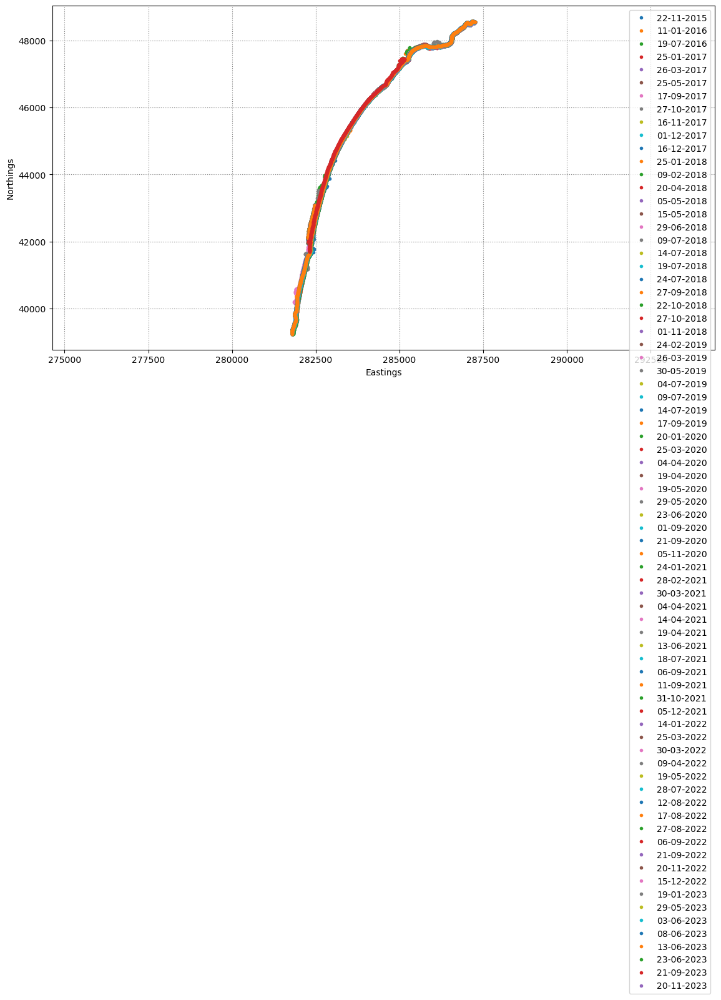

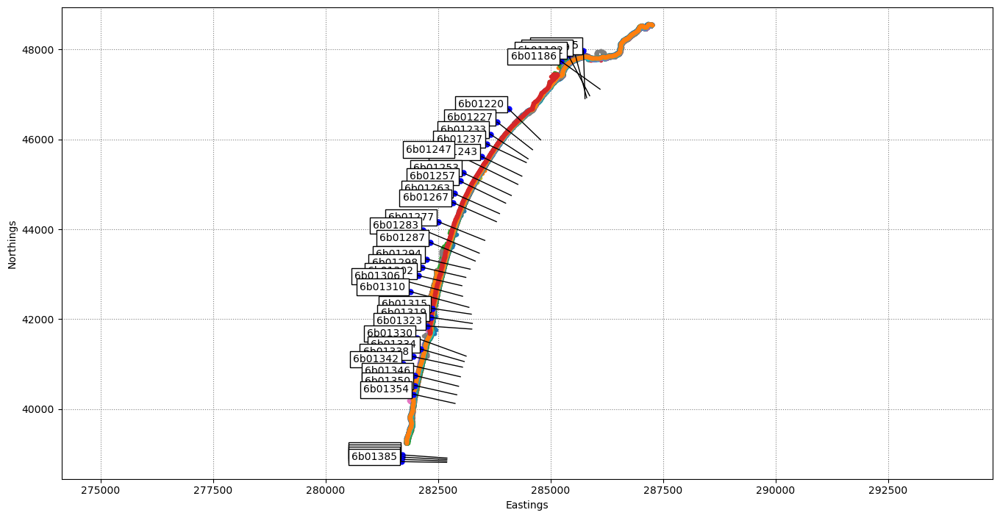

In [18]:
fig = plt.figure(figsize=[15,8], tight_layout=True)
plt.axis('equal')
plt.xlabel('Eastings')
plt.ylabel('Northings')
plt.grid(linestyle=':', color='0.5')
for i in range(len(output['shorelines'])):
    sl = output['shorelines'][i]
    date = output['dates'][i]
    plt.plot(sl[:,0], sl[:,1], '.', label=date.strftime('%d-%m-%Y'))
for i,key in enumerate(list(transects.keys())):
    plt.plot(transects[key][0,0],transects[key][0,1], 'bo', ms=5)
    plt.plot(transects[key][:,0],transects[key][:,1],'k-',lw=1)
    plt.text(transects[key][0,0]-100, transects[key][0,1]+100, key,
                va='center', ha='right', bbox=dict(boxstyle="square", ec='k',fc='w'))

%matplotlib inline
plt.show()

Now, we intersect 2D shorelines with the shore-normal transects to obtain time-series of cross-shore distance along each transect.

One way is to simply compute the intersection as the median of the shoreline points within a certain range (`along_dist`).

In [19]:
# along-shore distance over which to consider shoreline points to compute the median intersection
settings_transects = {'along_dist':25}
cross_distance = SDS_transects.compute_intersection(output, transects, settings_transects) 

However, the shorelines can often be noisy (small loops, double intersections, etc), therefore a few parameters can be set to quality-control the intersections between tranects and shorelines with a more advanced function `compute_intersection_QC()`:
- `along_dist`: (in metres),
    alongshore distance to caluclate the intersection (median of points 
    within this distance). 
- `min_points`:  minimum number of shoreline points to calculate an intersection.
- `max_std`: (in metres) maximum STD for the shoreline points within the alongshore range, 
    if STD is above this value a NaN is returned for this intersection.
- `max_range`: (in metres) maximum RANGE for the shoreline points within the alongshore range, 
    if RANGE is above this value a NaN is returned for this intersection.
- `min_chainage`: (in metres) furthest distance landward of the transect origin that an intersection is 
    accepted, beyond this point a NaN is returned.
- `multiple_inter`: ('auto','nan','max') defines how to deal with multiple shoreline intersections
- `auto_prc`: (value between 0 and 1) by default 0.1, percentage of the time that a multiple intersection needs to be present to use the max in auto mode

Default parameters for the more quality-controlled intersections are provided below and should work in most cases (leave as it is if unsure).

The `multiple_inter` setting helps to deal with multiple shoreline intersections along the same transect. This is quite common, for example when there is a lagoon behind the beach and the transect crosses two water bodies. The function will try to identify this cases and the user can choose whether to:
- `'nan'`: always assign a NaN when there are multile intersections.
- `'max'`: always take the max (intersection the furtherst seaward).
- `'auto'`: let the function decide transect by transect, and if it thinks there are two water bodies, take the max.
If `'auto'` is chosen, the `auto_prc` parameter will define when to use the max, by default it is set to 0.1, which means that the function thinks there are two water bodies if 10% of the time-series show multiple intersections.

In [20]:
settings_transects = { # parameters for computing intersections
                      'along_dist':          25,        # along-shore distance to use for computing the intersection
                      'min_points':          3,         # minimum number of shoreline points to calculate an intersection
                      'max_std':             15,        # max std for points around transect
                      'max_range':           30,        # max range for points around transect
                      'min_chainage':        -100,      # largest negative value along transect (landwards of transect origin)
                      'multiple_inter':      'auto',    # mode for removing outliers ('auto', 'nan', 'max')
                      'prc_multiple':         0.1,      # percentage of the time that multiple intersects are present to use the max
                     }
cross_distance = SDS_transects.compute_intersection_QC(output, transects, settings_transects) 

Computing transect shoreline intersections: 100%|██████████████████████████████████████| 36/36 [00:54<00:00,  1.52s/it]


Plot the time-series of shoreline change along each transect

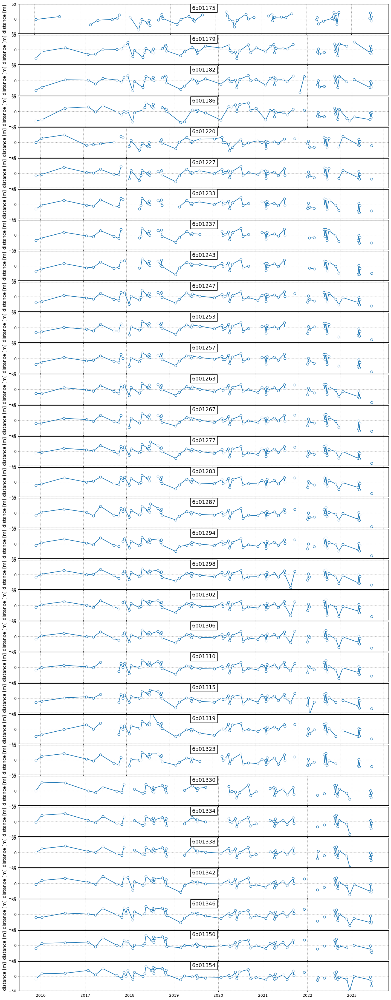

In [21]:
fig = plt.figure(figsize=[15,45], tight_layout=True)
gs = gridspec.GridSpec(len(cross_distance),1)
gs.update(left=0.05, right=0.95, bottom=0.05, top=0.95, hspace=0.05)
for i,key in enumerate(cross_distance.keys()):
    if np.all(np.isnan(cross_distance[key])):
        continue
    ax = fig.add_subplot(gs[i,0])
    ax.grid(linestyle=':', color='0.5')
    ax.set_ylim([-50,50])
    ax.plot(output['dates'], cross_distance[key]- np.nanmedian(cross_distance[key]), '-o', ms=6, mfc='w')
    ax.set_ylabel('distance [m]', fontsize=12)
    ax.text(0.5,0.95, key, bbox=dict(boxstyle="square", ec='k',fc='w'), ha='center',
            va='top', transform=ax.transAxes, fontsize=14)  

%matplotlib inline
plt.show()

In [22]:
# save a .csv file for Excel users
out_dict = dict([])
out_dict['dates'] = output['dates']
for key in transects.keys():
    out_dict[key] = cross_distance[key]
df = pd.DataFrame(out_dict)
fn = os.path.join(settings['inputs']['filepath'],settings['inputs']['sitename'],
                  'transect_time_series.csv')
df.to_csv(fn, sep=',')
print('Time-series of the shoreline change along the transects saved as:\n%s'%fn)

Time-series of the shoreline change along the transects saved as:
C:\Users\helen\Documents\data\STARTBAY\transect_time_series.csv


## 4. Tidal correction

This last section shows how to tidally-correct the time-series of shoreline change using time-series of tide level and an estimate of the beach slope.

The dates are in UTC time, as the CoastSat shorelines are also in UTC, and the datum for the water levels is approx. Mean Sea Level.

We assume that the beach slope at Start Bay is 0.200 along all transects. This was calculated in the slope notebook.

**Note**: if you don't have measured water levels and beach slope, it is possible to obtain an estimate of the beach slope and time-series of modelled tide levels at the time of image acquisition from the [FES2014](https://www.aviso.altimetry.fr/es/data/products/auxiliary-products/global-tide-fes/description-fes2014.html) global tide model by using the [CoastSat.slope](https://github.com/kvos/CoastSat.slope) repository (see [this publication](https://doi.org/10.1029/2020GL088365) for more details, open acess preprint [here](https://www.essoar.org/doi/10.1002/essoar.10502903.1)). Instructions on how to install the global tide model are available [here](https://github.com/kvos/CoastSat.slope/blob/master/doc/FES2014_installation.md).

In [23]:
#Helen Code

import subprocess

# Define the command and its arguments
command = [
    "python", "predict_tides.py",
    "-C", r"C:\Users\helen\Documents\data\STARTBAY\map_StartBay_Offshore.geojson",
    "-T", r"C:\Users\helen\Documents\data\STARTBAY\transect_time_series.csv",
    "-M", r"C:\Users\helen\tide_model",
    "-R", r"C:\Users\helen\Documents\data\STARTBAY\tide_regions_map.geojson"
]

# Execute the command
result = subprocess.run(command, capture_output=True, text=True)

# Print the output and error (if any)
print("Output:\n", result.stdout)
print("Error:\n", result.stderr)

Output:
 Model regions geojson file not found at the default location. Please provide the path manually.
                      dates     6b01175     6b01179  ...  6b01383  6b01384  6b01385
0 2015-11-22 11:23:56+00:00         NaN  123.561450  ...      NaN      NaN      NaN
1 2016-01-11 11:33:19+00:00  132.436424  145.250777  ...      NaN      NaN      NaN
2 2016-07-19 11:21:17+00:00  142.236792  158.567042  ...      NaN      NaN      NaN
3 2017-01-25 11:23:33+00:00         NaN  136.379359  ...      NaN      NaN      NaN
4 2017-03-26 11:21:08+00:00  114.740095  137.426852  ...      NaN      NaN      NaN

[5 rows x 37 columns]
Predicting tides this may take some time....
Loading regions from GeoJSON file: C:\Users\helen\Documents\data\STARTBAY\tide_regions_map.geojson
Modeling tides for all points
Loading the tide model from: C:\Users\helen\tide_model\region4
Tide predictions saved to C:\Users\helen\Documents\tidal_predictions.csv

Error:
 


In [24]:
#Instructions provided by Sharon to create tidal_predictions.csv
#python predict_tides.py -C "C:\Users\helen\Documents\data\STARTBAY\map_StartBay_Offshore.geojson" -T "C:\Users\helen\Documents\data\STARTBAY\transect_time_series.csv"  -M "C:\Users\helen\tide_model" -R "C:\Users\helen\Documents\data\STARTBAY\tide_regions_map.geojson"
#Amended code above as this would not process in Jupyter notebook. 

Extracting closest points: 100%
The default method of getting the closest datapoint failed. Trying the second method


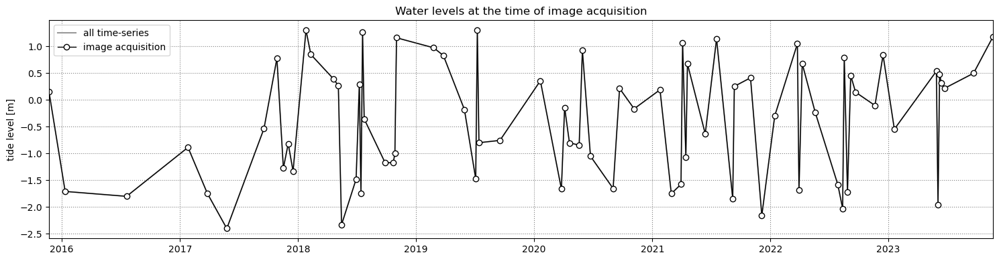

In [25]:
# load the measured tide data
# filepath = os.path.join(os.getcwd(),'examples','sitename_tides.csv')
filepath = r'C:\Users\helen\Documents\tidal_predictions.csv'
# filepath = r"C:\development\doodleverse\coastseg\CoastSeg\scripts\tidal_predictions_2_points.csv"
tide_data = pd.read_csv(filepath)
dates_ts = [pd.to_datetime(_).to_pydatetime() for _ in tide_data['dates']]
tides_ts = np.array(tide_data['tide'])

# get tide levels corresponding to the time of image acquisition
dates_sat = output['dates']
try:
    tides_sat = SDS_tools.get_closest_datapoint(dates_sat, dates_ts, tides_ts)
except Exception as e:
    print("\nThe default method of getting the closest datapoint failed. Trying the second method")
    tides_sat = SDS_tools.get_nearest_datapoint(dates_sat, dates_ts, tides_ts)
    
  
# plot the subsampled tide data
fig, ax = plt.subplots(1,1,figsize=(15,4), tight_layout=True)
ax.grid(which='major', linestyle=':', color='0.5')
ax.plot(dates_ts, tides_ts, '-', color='0.6', label='all time-series')
ax.plot(dates_sat, tides_sat, '-o', color='k', ms=6, mfc='w',lw=1, label='image acquisition')
ax.set(ylabel='tide level [m]',xlim=[dates_sat[0],dates_sat[-1]], title='Water levels at the time of image acquisition');
ax.legend();

%matplotlib inline
plt.show()

Apply tidal correction using a linear slope and a reference elevation to which project all the time-series of cross-shore change (to get time-series at Mean Sea Level, set `reference_elevation` to 0. You also need an estimate of the beach slope. 

Tidally-corrected time-series of the shoreline change along the transects saved as:
C:\Users\helen\Documents\data\STARTBAY\transect_time_series_tidally_corrected.csv


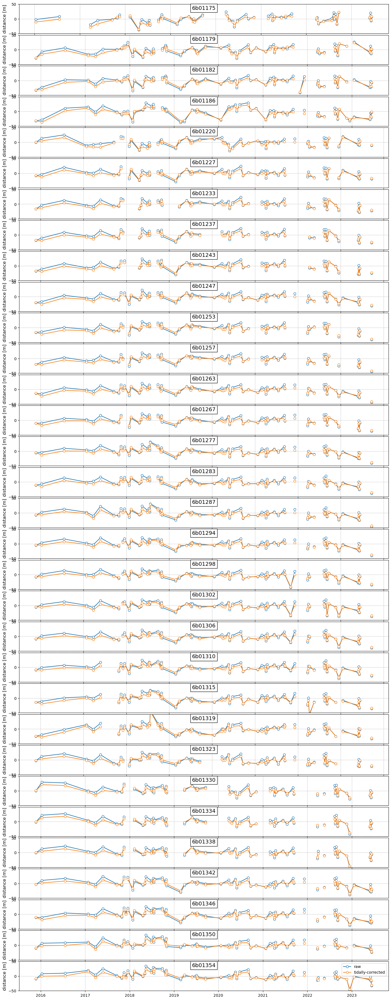

In [26]:
# tidal correction along each transect
reference_elevation = 0 # elevation at which you would like the shoreline time-series to be
beach_slope = 0.200 #From the beach slope notebook
cross_distance_tidally_corrected = {}
for key in cross_distance.keys():
    correction = (tides_sat-reference_elevation)/beach_slope
    cross_distance_tidally_corrected[key] = cross_distance[key] + correction
    
# store the tidally-corrected time-series in a .csv file
out_dict = dict([])
out_dict['dates'] = dates_sat
for key in cross_distance_tidally_corrected.keys():
    out_dict[key] = cross_distance_tidally_corrected[key]
df = pd.DataFrame(out_dict)
fn = os.path.join(settings['inputs']['filepath'],settings['inputs']['sitename'],
                  'transect_time_series_tidally_corrected.csv')
df.to_csv(fn, sep=',')
print('Tidally-corrected time-series of the shoreline change along the transects saved as:\n%s'%fn)

# plot the time-series of shoreline change (both raw and tidally-corrected)
fig = plt.figure(figsize=[15,45], tight_layout=True)
gs = gridspec.GridSpec(len(cross_distance),1)
gs.update(left=0.05, right=0.95, bottom=0.05, top=0.95, hspace=0.05)
for i,key in enumerate(cross_distance.keys()):
    if np.all(np.isnan(cross_distance[key])):
        continue
    ax = fig.add_subplot(gs[i,0])
    ax.grid(linestyle=':', color='0.5')
    ax.set_ylim([-50,50])
    ax.plot(output['dates'], cross_distance[key]- np.nanmedian(cross_distance[key]), '-o', ms=6, mfc='w', label='raw')
    ax.plot(output['dates'], cross_distance_tidally_corrected[key]- np.nanmedian(cross_distance[key]), '-o', ms=6, mfc='w', label='tidally-corrected')
    ax.set_ylabel('distance [m]', fontsize=12)
    ax.text(0.5,0.95, key, bbox=dict(boxstyle="square", ec='k',fc='w'), ha='center',
            va='top', transform=ax.transAxes, fontsize=14)
ax.legend();

%matplotlib inline
plt.show()

## 5. Time-series post-processing

Finally, we can post-process the time-series of shoreline change to remove obvious outliers and spikes in the data and average the time-series over different time-frames (seasonally or monthly).

To demonstrate these functionalities, we load a full time-series of shoreline change at Start Bay from Landsat imagery between 1999 and 2023. These shorelines were mapped automatically without manual quality control, intersected with the transects and tidally-corrected.

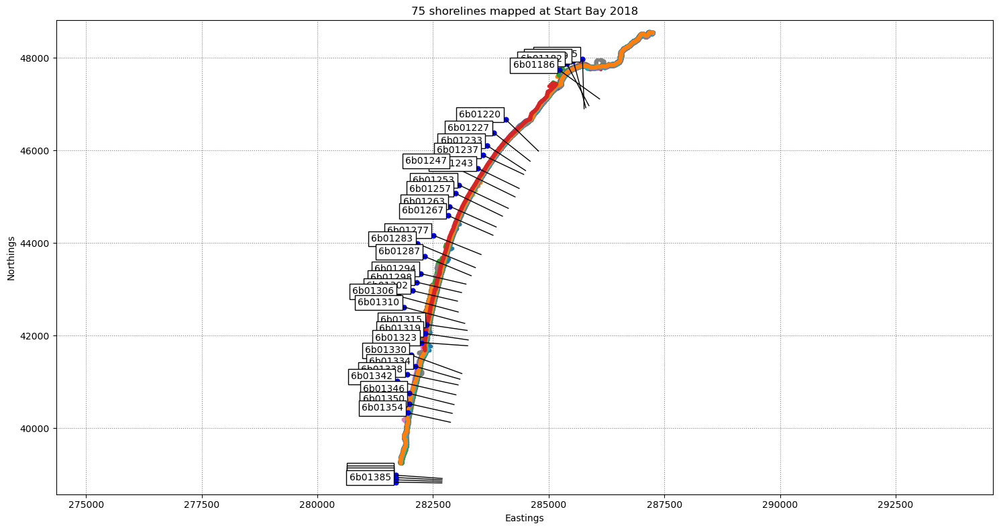

In [27]:
# load mapped shorelines from 1984
filename_output = os.path.join(os.getcwd(),'data\\STARTBAY','startbay_output.pkl')
with open(filename_output, 'rb') as f:
    output = pickle.load(f) 

# plot the mapped shorelines
fig = plt.figure(figsize=[15,8], tight_layout=True)
plt.axis('equal')
plt.xlabel('Eastings')
plt.ylabel('Northings')
plt.grid(linestyle=':', color='0.5')
plt.title('%d shorelines mapped at Start Bay 2018'%len(output['shorelines']))
for i in range(len(output['shorelines'])):
    sl = output['shorelines'][i]
    date = output['dates'][i]
    plt.plot(sl[:,0], sl[:,1], '.', label=date.strftime('%d-%m-%Y'))
for i,key in enumerate(list(transects.keys())):
    plt.plot(transects[key][0,0],transects[key][0,1], 'bo', ms=5)
    plt.plot(transects[key][:,0],transects[key][:,1],'k-',lw=1)
    plt.text(transects[key][0,0]-100, transects[key][0,1]+100, key,
             va='center', ha='right', bbox=dict(boxstyle="square", ec='k',fc='w'))

# load long time-series (1984-2021)
filepath = os.path.join(os.getcwd(),'data\\STARTBAY','transect_time_series_tidally_corrected.csv')
df = pd.read_csv(filepath, parse_dates=['dates'])
dates = [_.to_pydatetime() for _ in df['dates']]
cross_distance = dict([])
for key in transects.keys():
    cross_distance[key] = np.array(df[key])

plt.show()

#### 5.1 Despiking the time-series

The tidally-corrected time-series of shoreline change obtained with the steps above may still contain some outliers (from cloud shadows, false detections etc). The function `SDS_transects.reject_outliers()` was developed to remove obvious outliers in the time-series, by removing the points that do not make physical sense in a shoreline change setting. 

For example, the shoreline can experience rapid erosion after a large storm, but it will then take time to recover and return to its previous state. Therefore, if the shoreline erodes/accretes suddenly of a significant amount (`max_cross_change`) and then immediately returns to its previous state, this spike does not make any physical sense and can be considered an outlier. Additionally, this funciton also checks that the Otsu thresholds used to map the shoreline are within the typical range defined by `otsu_threshold`, with values outside this range identified as outliers.

6b01175  - outliers removed: 0
6b01179  - outliers removed: 0
6b01182  - outliers removed: 1
6b01186  - outliers removed: 0
6b01220  - outliers removed: 0
6b01227  - outliers removed: 0
6b01233  - outliers removed: 0
6b01237  - outliers removed: 0
6b01243  - outliers removed: 0
6b01247  - outliers removed: 0
6b01253  - outliers removed: 0
6b01257  - outliers removed: 0
6b01263  - outliers removed: 0
6b01267  - outliers removed: 0
6b01277  - outliers removed: 0
6b01283  - outliers removed: 0
6b01287  - outliers removed: 0
6b01294  - outliers removed: 0
6b01298  - outliers removed: 1
6b01302  - outliers removed: 0
6b01306  - outliers removed: 0
6b01310  - outliers removed: 0
6b01315  - outliers removed: 0
6b01319  - outliers removed: 0
6b01323  - outliers removed: 0
6b01330  - outliers removed: 0
6b01334  - outliers removed: 0
6b01338  - outliers removed: 0
6b01342  - outliers removed: 0
6b01346  - outliers removed: 0
6b01350  - outliers removed: 0
6b01354  - outliers removed: 0


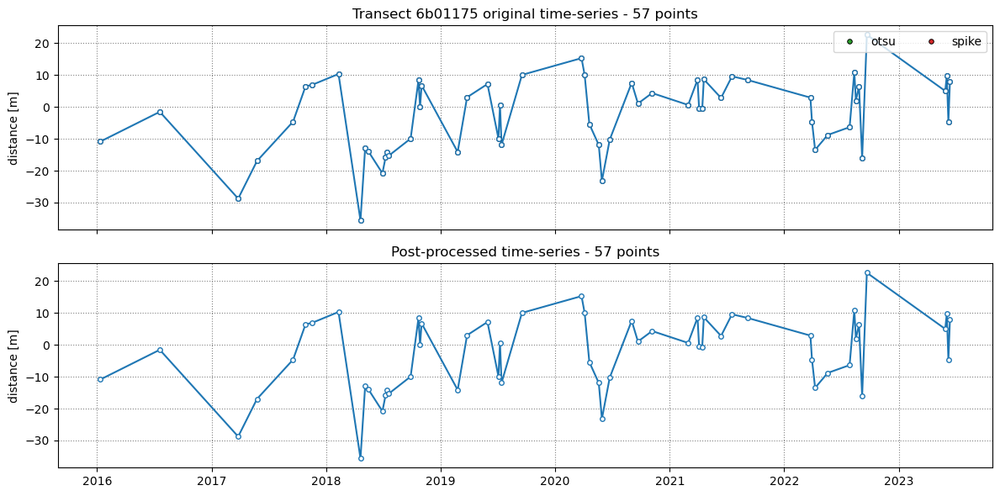

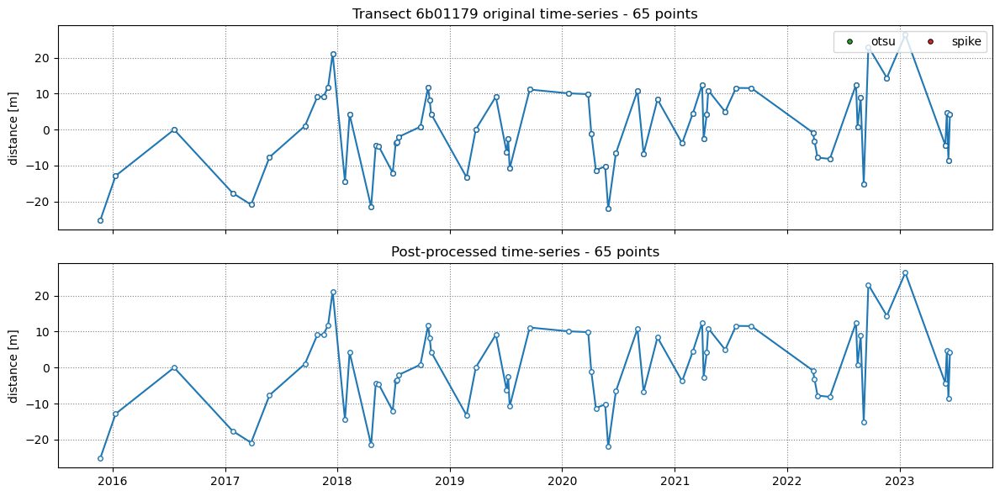

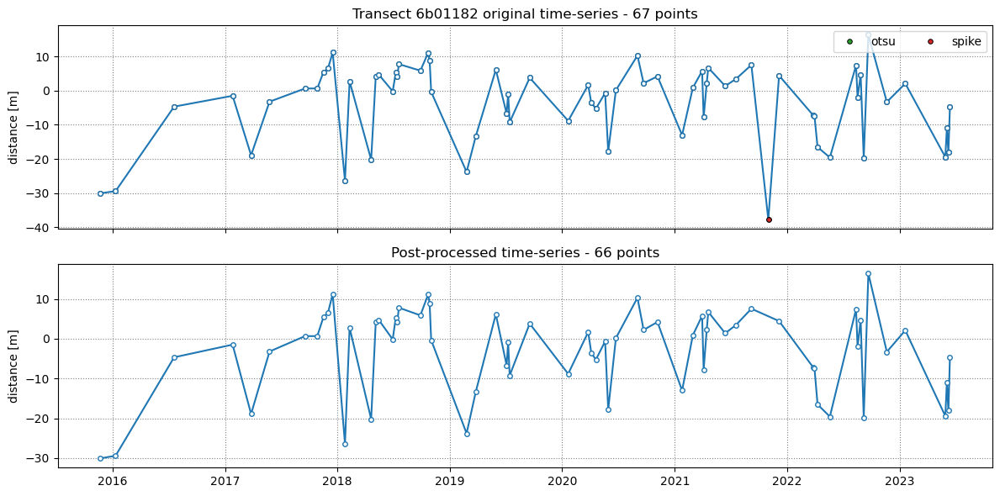

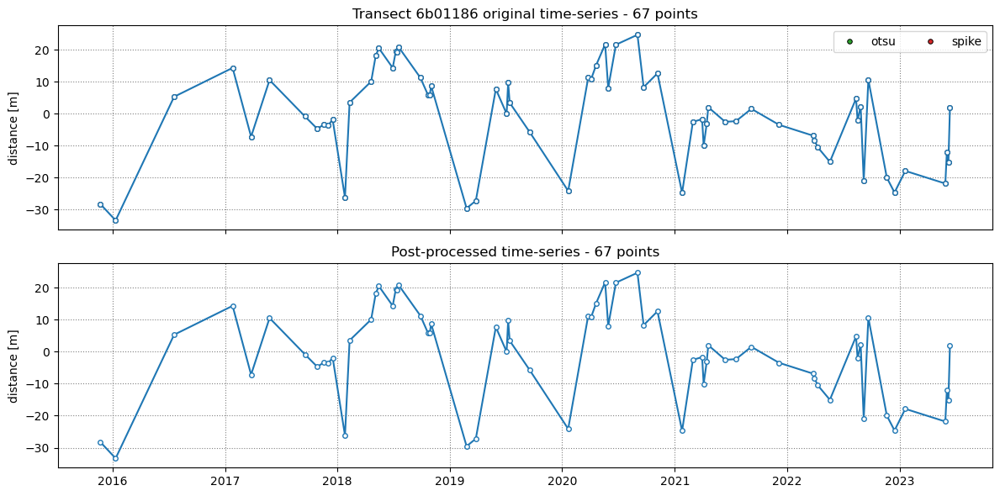

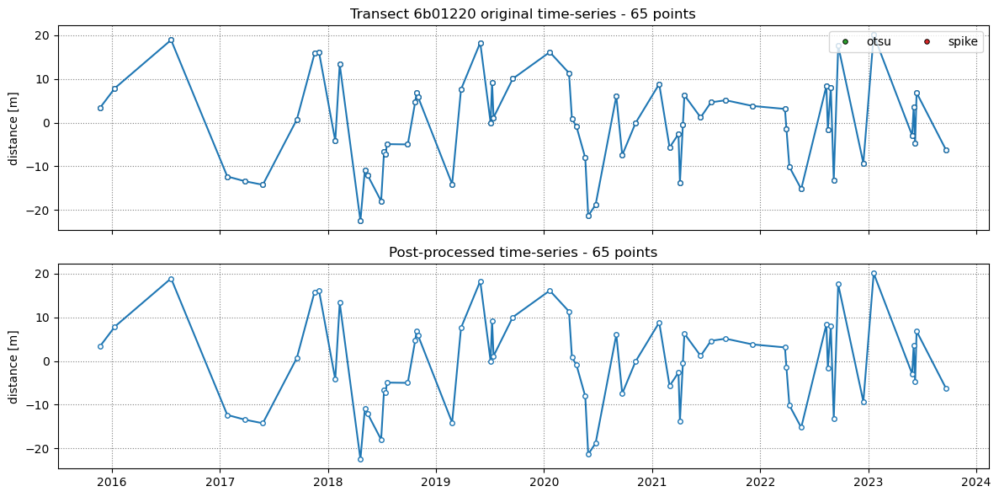

...

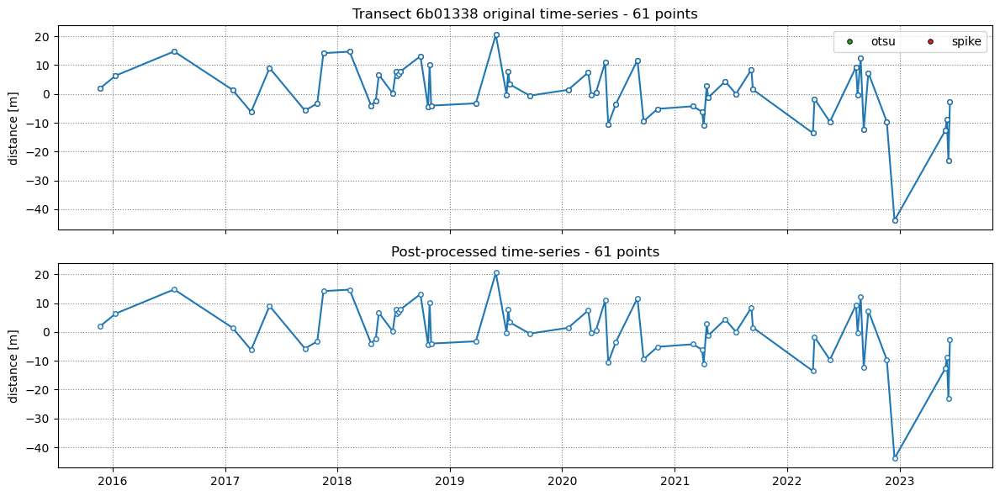

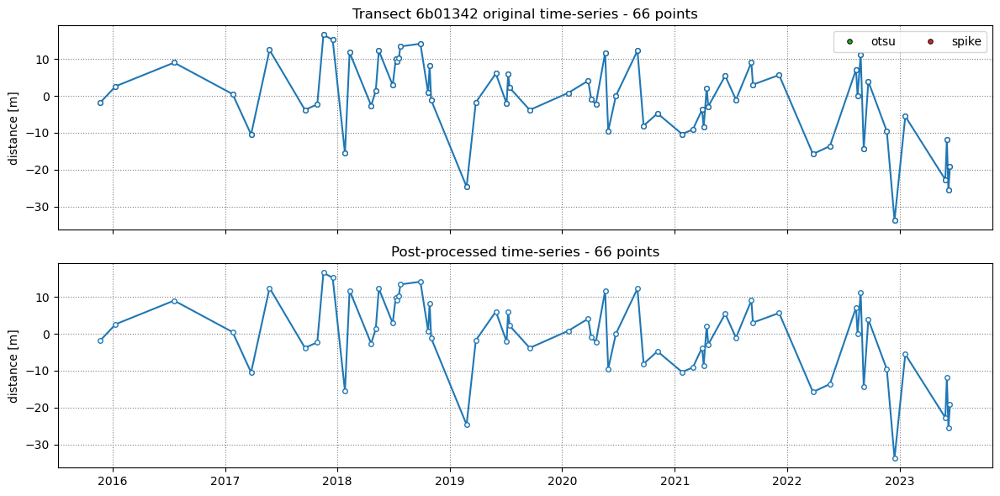

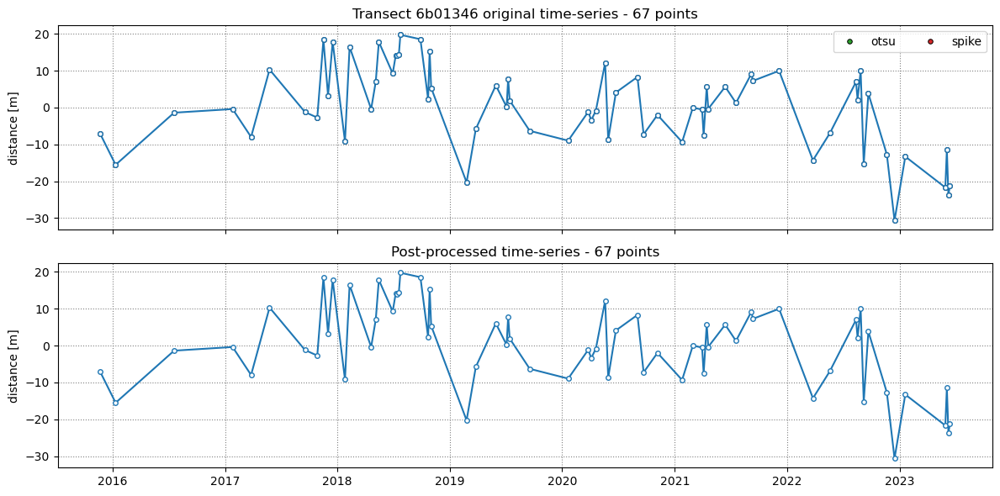

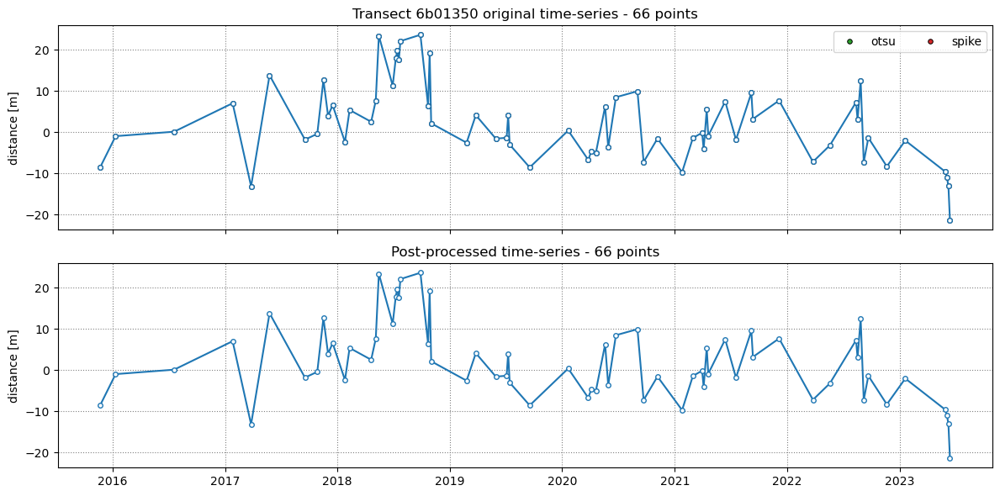

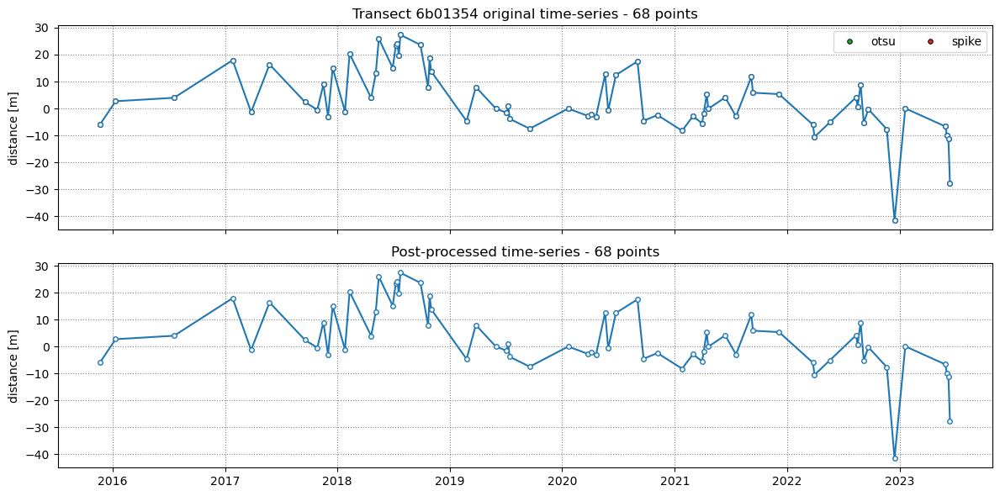

In [28]:
# remove outliers in the time-series (coastal despiking)
settings_outliers = {'max_cross_change':   40,             # maximum cross-shore change observable between consecutive timesteps
                     'otsu_threshold':     [-.5,0],        # min and max intensity threshold use for contouring the shoreline
                     'plot_fig':           True,           # whether to plot the intermediate steps
                    }
cross_distance = SDS_transects.reject_outliers(cross_distance,output,settings_outliers)

%matplotlib inline
plt.show()

We can also plot the Otsu threholds for the shorelines mapped at this site to see if there are any obvious outliers and adjust the values of `otsu_threshold`.

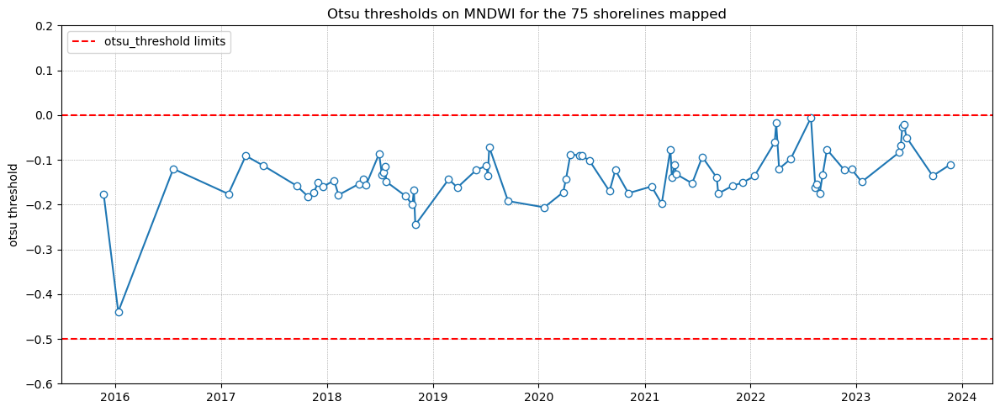

In [29]:
# plot Otsu thresholds for the mapped shorelines
fig,ax = plt.subplots(1,1,figsize=[12,5],tight_layout=True)
ax.grid(which='major',ls=':',lw=0.5,c='0.5')
ax.plot(output['dates'],output['MNDWI_threshold'],'o-',mfc='w')
ax.axhline(y=-0.5,ls='--',c='r',label='otsu_threshold limits')
ax.axhline(y=0,ls='--',c='r')
ax.set(title='Otsu thresholds on MNDWI for the %d shorelines mapped'%len(output['shorelines']),
       ylim=[-0.6,0.2],ylabel='otsu threshold')
ax.legend(loc='upper left')
fig.savefig(os.path.join(inputs['filepath'], inputs['sitename'], 'otsu_threhsolds.jpg'))

%matplotlib inline
plt.show()

#### 5.2 Seasonal averaging

The cell below shows how to calculate seasonal averages on the time-series with `SDS_transects.seasonal_average()` and plot them. 

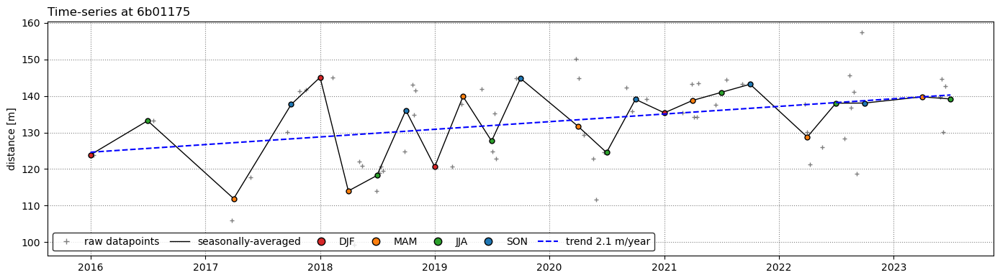

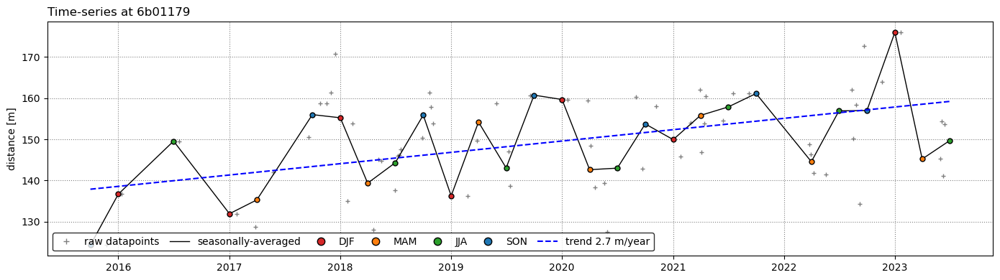

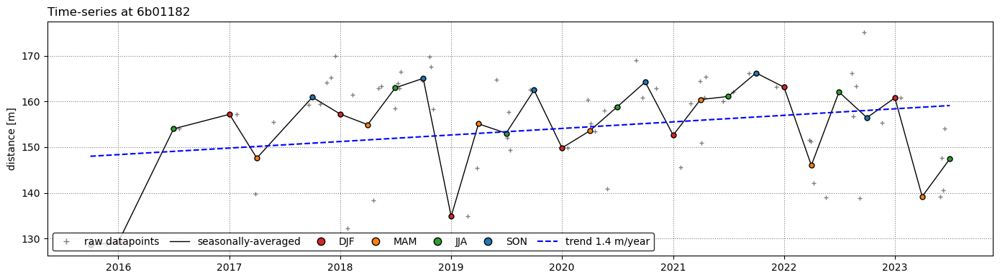

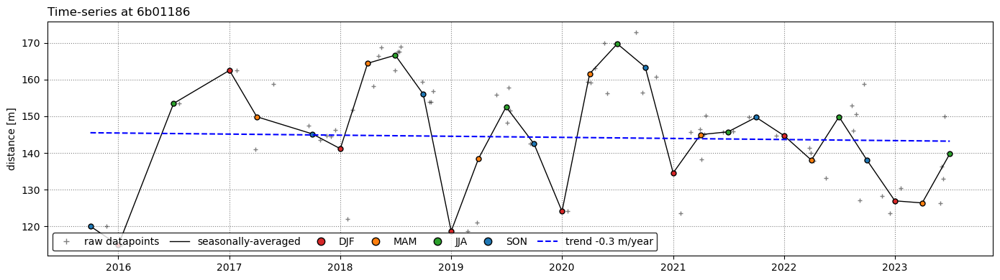

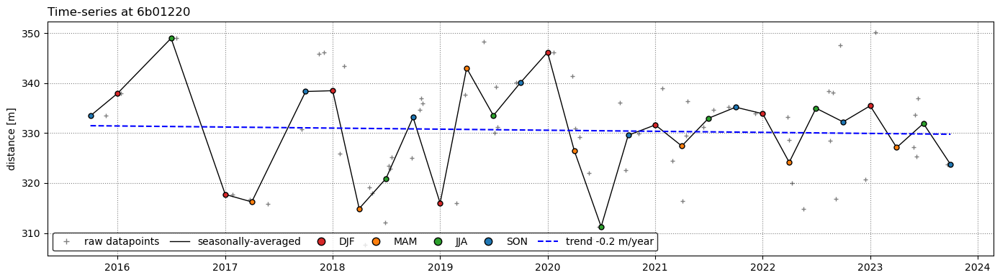

...

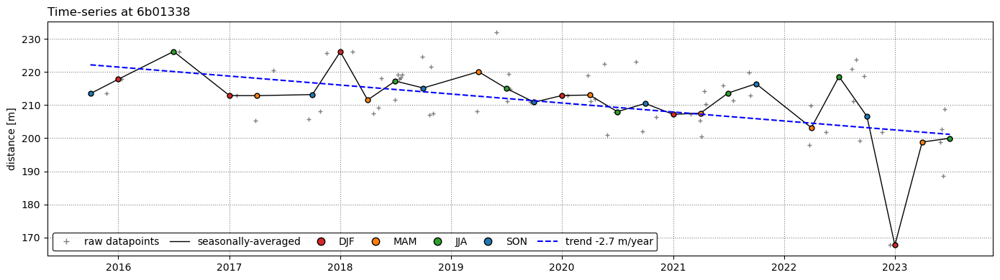

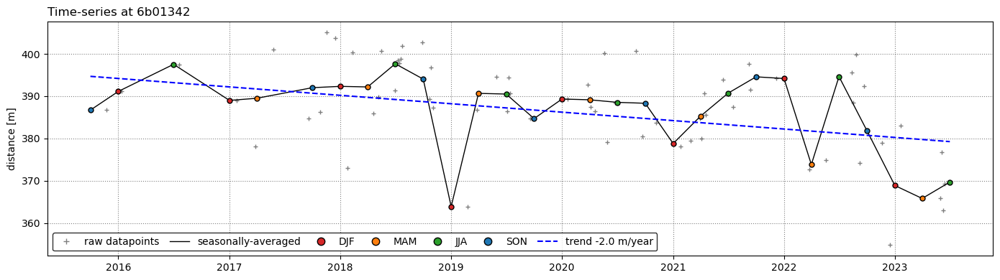

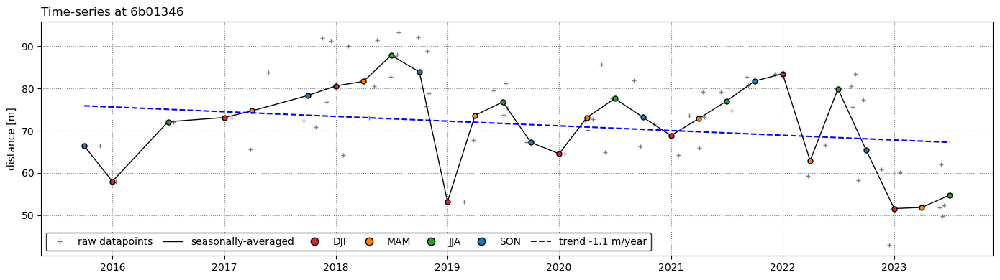

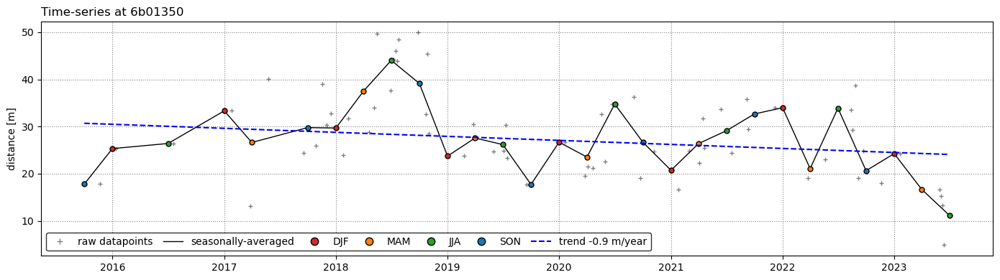

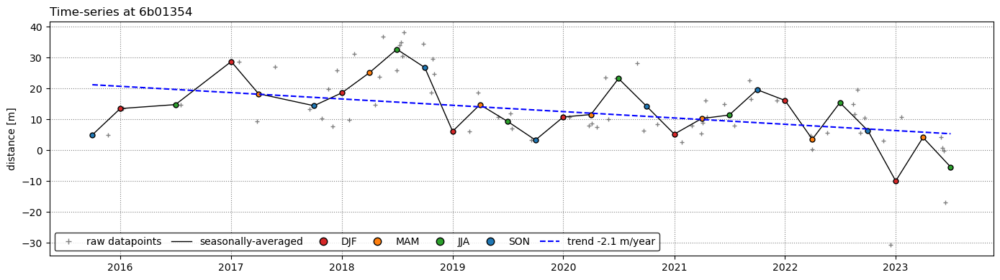

In [30]:
season_colors = {'DJF':'C3', 'MAM':'C1', 'JJA':'C2', 'SON':'C0'}
for key in cross_distance.keys():
    chainage = cross_distance[key]
    # remove nans
    idx_nan = np.isnan(chainage)
    dates_nonan = [dates[_] for _ in np.where(~idx_nan)[0]]
    chainage = chainage[~idx_nan] 
    
    # compute shoreline seasonal averages (DJF, MAM, JJA, SON)
    dict_seas, dates_seas, chainage_seas, list_seas = SDS_transects.seasonal_average(dates_nonan, chainage)
    
    # calculate long-term trend
    trend, y =  SDS_transects.calculate_trend(dates_seas, chainage_seas)
    
    # plot seasonal averages
    fig,ax=plt.subplots(1,1,figsize=[14,4],tight_layout=True)
    ax.grid(which='major', linestyle=':', color='0.5')
    ax.set_title('Time-series at %s'%key, x=0, ha='left')
    ax.set(ylabel='distance [m]')
    ax.plot(dates_nonan, chainage,'+', lw=1, color='k', mfc='w', ms=4, alpha=0.5,label='raw datapoints')
    ax.plot(dates_seas, chainage_seas, '-', lw=1, color='k', mfc='w', ms=4, label='seasonally-averaged')
    for k,seas in enumerate(dict_seas.keys()):
        ax.plot(dict_seas[seas]['dates'], dict_seas[seas]['chainages'],
                 'o', mec='k', color=season_colors[seas], label=seas,ms=5)
    ax.plot(dates_seas,y,'--',color='b', label='trend %.1f m/year'%trend)
    ax.legend(loc='lower left',ncol=7,markerscale=1.5,frameon=True,edgecolor='k',columnspacing=1)

%matplotlib inline
plt.show()

#### 5.3 Monthly averaging

The cell below shows how to calculate seasonal averages on the time-series with `SDS_transects.monthly_average()` and plot them.

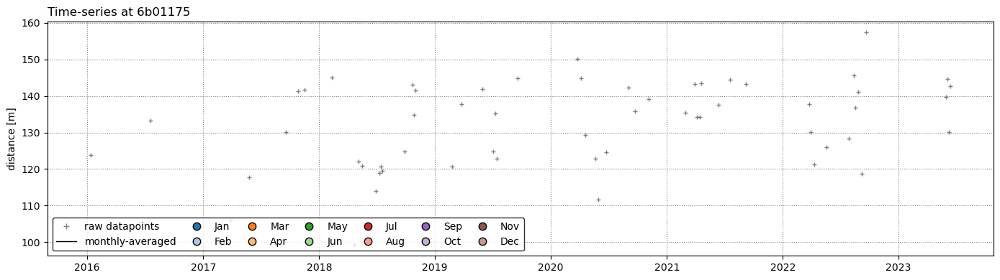

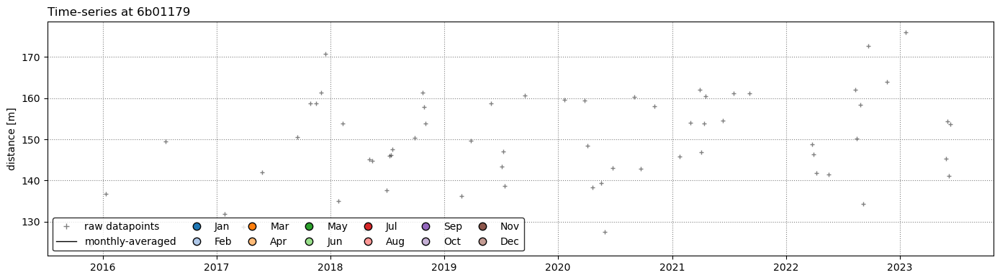

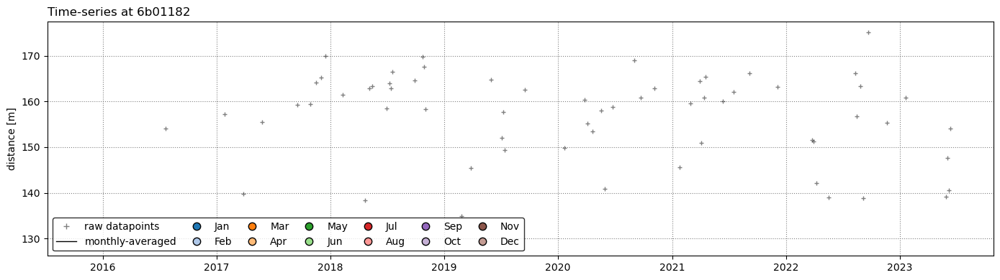

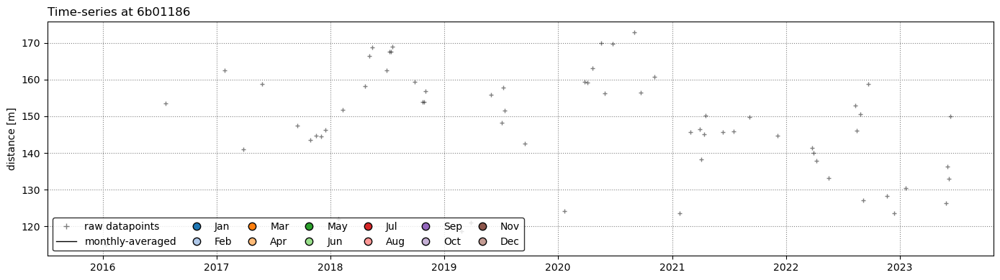

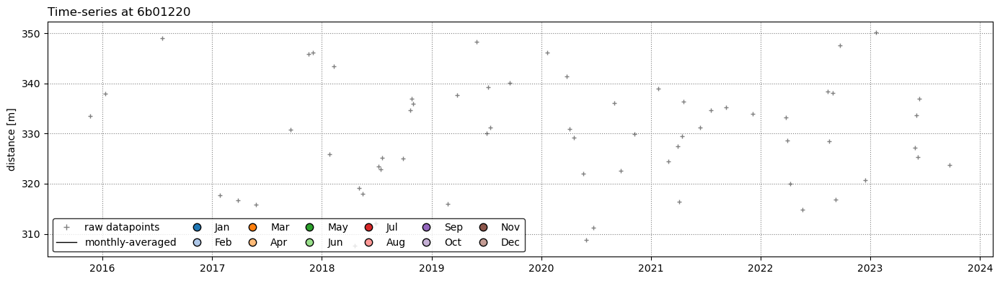

...

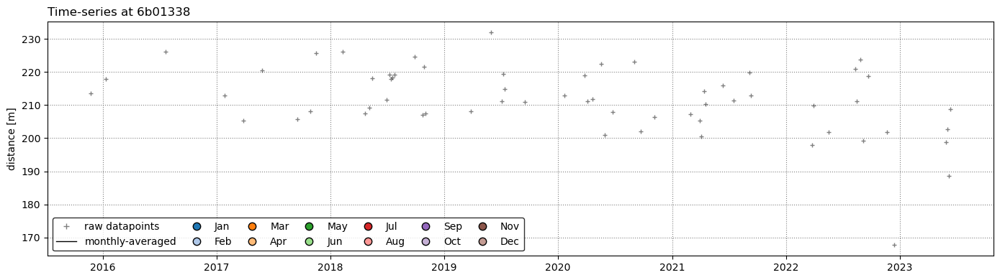

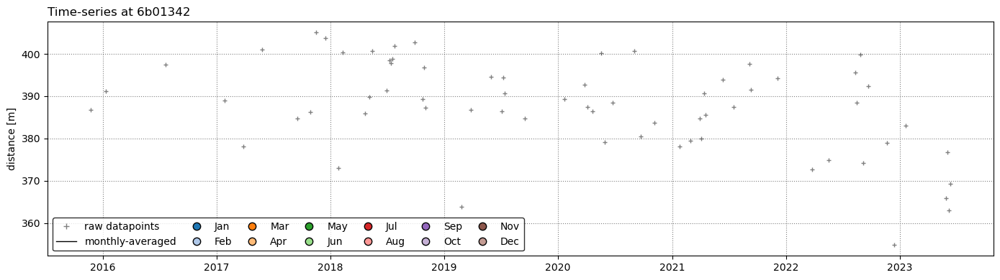

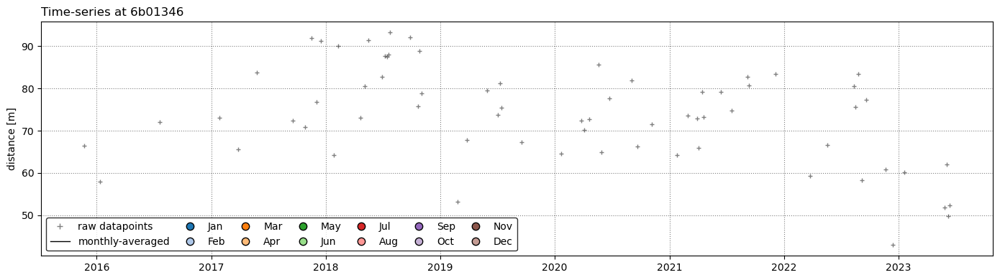

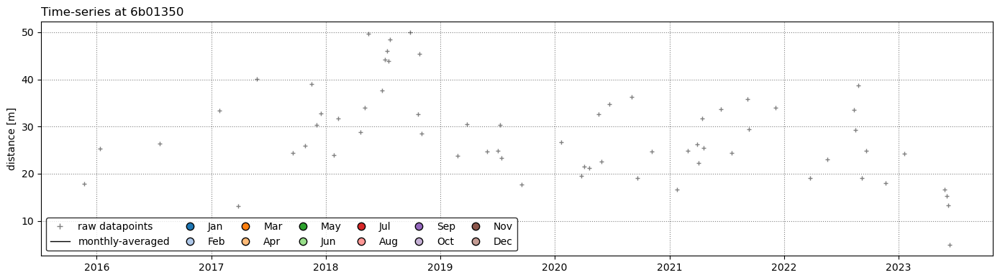

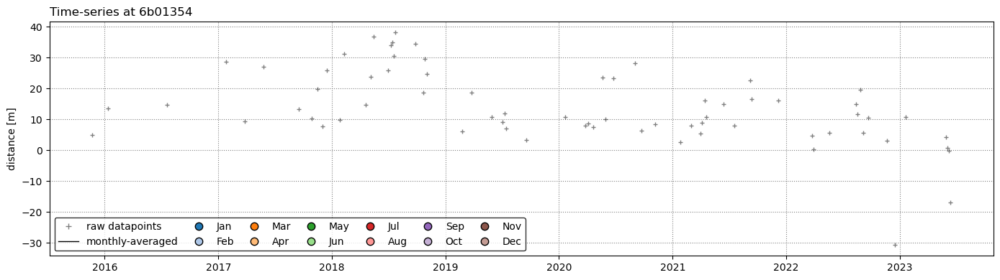

In [31]:
month_colors = plt.cm.get_cmap('tab20')
for key in cross_distance.keys():
    chainage = cross_distance[key]
    # remove nans
    idx_nan = np.isnan(chainage)
    dates_nonan = [dates[_] for _ in np.where(~idx_nan)[0]]
    chainage = chainage[~idx_nan] 
    
    # compute shoreline monthly averages
    dict_month, dates_month, chainage_month, list_month = SDS_transects.monthly_average(dates_nonan, chainage)
    
    # plot monthly averages
    fig,ax=plt.subplots(1,1,figsize=[14,4],tight_layout=True)
    ax.grid(which='major', linestyle=':', color='0.5')
    ax.set_title('Time-series at %s'%key, x=0, ha='left')
    ax.set(ylabel='distance [m]')
    ax.plot(dates_nonan, chainage,'+', lw=1, color='k', mfc='w', ms=4, alpha=0.5,label='raw datapoints')
    ax.plot(dates_month, chainage_month, '-', lw=1, color='k', mfc='w', ms=4, label='monthly-averaged')
    for k,month in enumerate(dict_month.keys()):
        ax.plot(dict_month[month]['dates'], dict_month[month]['chainages'],
                 'o', mec='k', color=month_colors(k), label=month,ms=5)
    ax.legend(loc='lower left',ncol=7,markerscale=1.5,frameon=True,edgecolor='k',columnspacing=1)

%matplotlib inline
plt.show()

## 6. Validation against surveys

This section provides a validation of the satellite-derived shorelines at Start Bay against the survey data, available at https://coastalmonitoring.org/cco/.

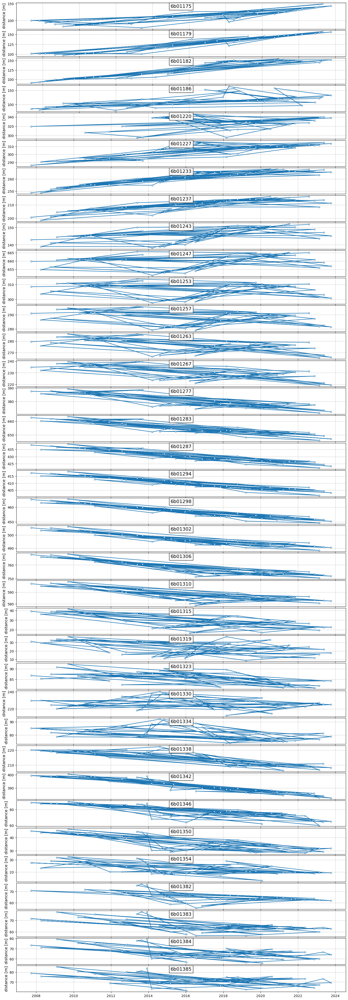

In [35]:
#Helen Amended Code

from scipy import interpolate
from datetime import datetime
import pytz

# Ensure inline plotting
%matplotlib inline

# read the csv file
fp_datasets = os.path.join(os.getcwd(), 'CCO', 'StartBay_Profiles.csv')
df = pd.read_csv(fp_datasets)
pf_names = list(np.unique(df['Profile ID']))

# select contour level
contour_level = 0.7

# initialise topo_profiles structure
topo_profiles = dict()
for i in range(len(pf_names)):
    # read dates
    df_pf = df.loc[df['Profile ID'] == pf_names[i]]
    dates_str = df_pf['Date']
    dates_unique = np.unique(dates_str)
    # loop through dates
    topo_profiles[pf_names[i]] = {'dates': [], 'chainages': []}
    for date in dates_unique:
        # extract chainage and elevation for that date
        df_date = df_pf.loc[dates_str == date]
        chainages = np.array(df_date['Chainage'])
        elevations = np.array(df_date['Elevation'])
        if len(chainages) == 0: continue
        # use interpolation to extract the chainage at the contour level
        f = interpolate.interp1d(elevations, chainages, bounds_error=False, fill_value='extrapolate')
        chainage_contour_level = f(contour_level)
        topo_profiles[pf_names[i]]['chainages'].append(chainage_contour_level)
        date_utc = pytz.utc.localize(datetime.strptime(date, '%d/%m/%Y'))
        topo_profiles[pf_names[i]]['dates'].append(date_utc)

# plot time-series
fig = plt.figure(figsize=[15, 45], tight_layout=True)
gs = gridspec.GridSpec(len(topo_profiles), 1)
gs.update(left=0.05, right=0.95, bottom=0.05, top=0.95, hspace=0.05)
for i, key in enumerate(topo_profiles.keys()):
    ax = fig.add_subplot(gs[i, 0])
    ax.grid(linestyle=':', color='0.5')
    ax.plot(topo_profiles[key]['dates'], topo_profiles[key]['chainages'], '-o', ms=4, mfc='w')
    ax.set_ylabel('distance [m]', fontsize=12)
    ax.text(0.5, 0.95, key, bbox=dict(boxstyle="square", ec='k', fc='w'), ha='center',
            va='top', transform=ax.transAxes, fontsize=14)

# Show the plot
plt.show()

# save a .pkl file
with open(os.path.join(os.getcwd(), 'data', 'STARTBAY', 'Startbay_ts_07m.pkl'), 'wb') as f:
    pickle.dump(topo_profiles, f)

Now compare the surveys to the satellite-derived shorelines from 1984 loaded previously.

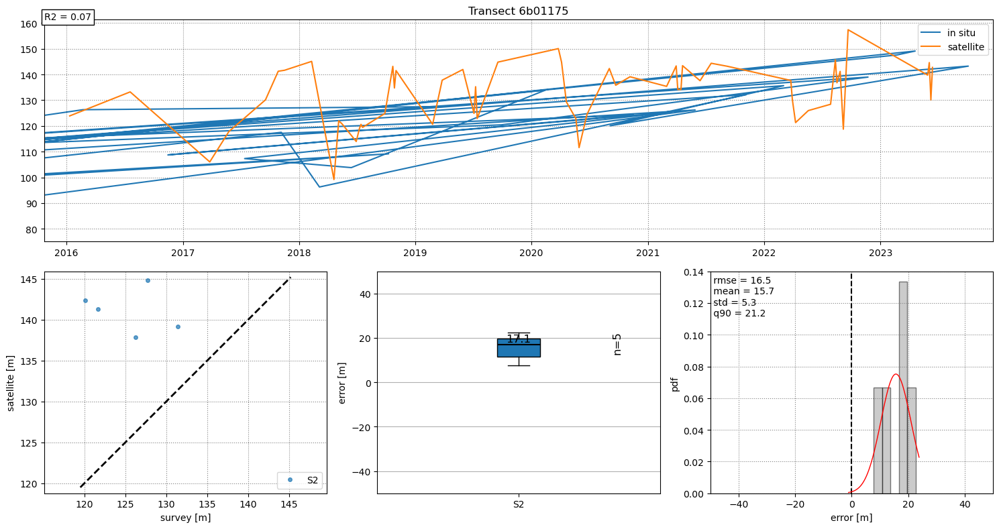

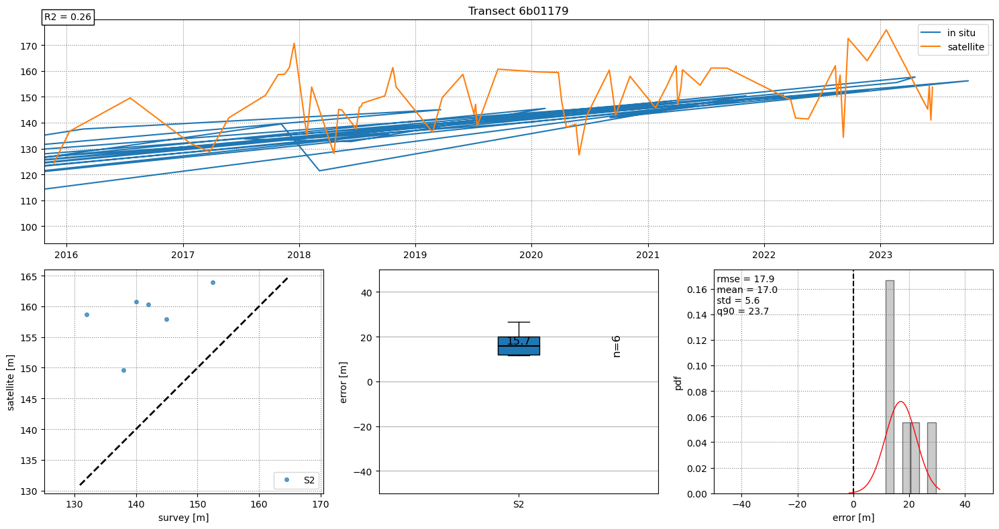

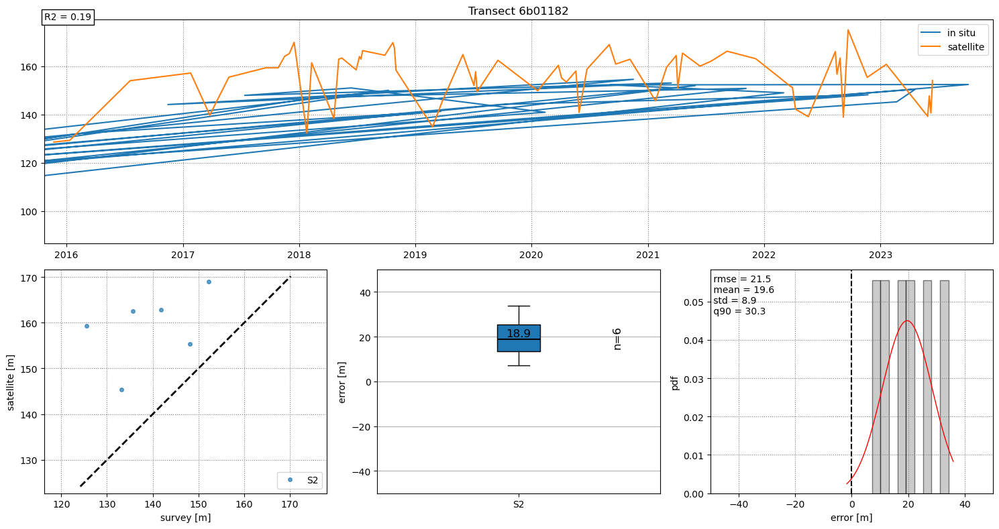

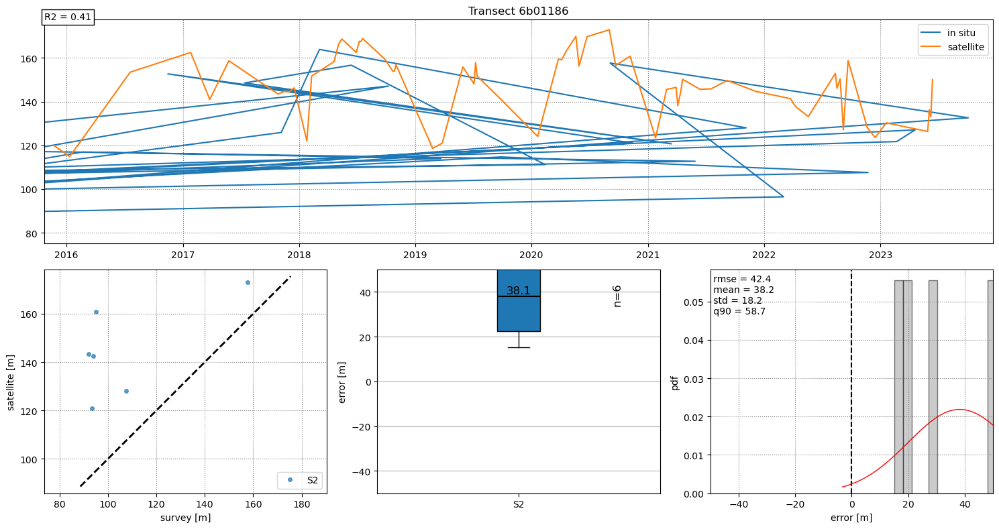

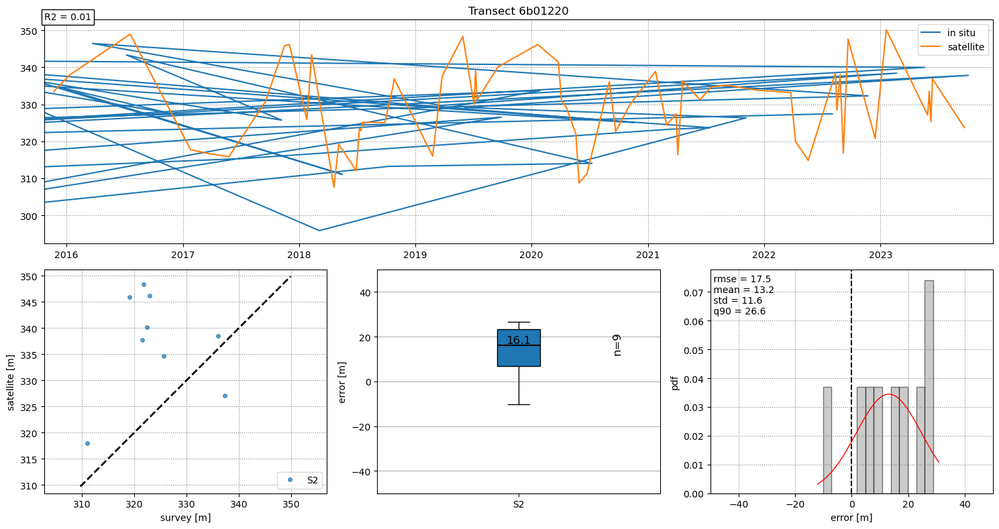

...

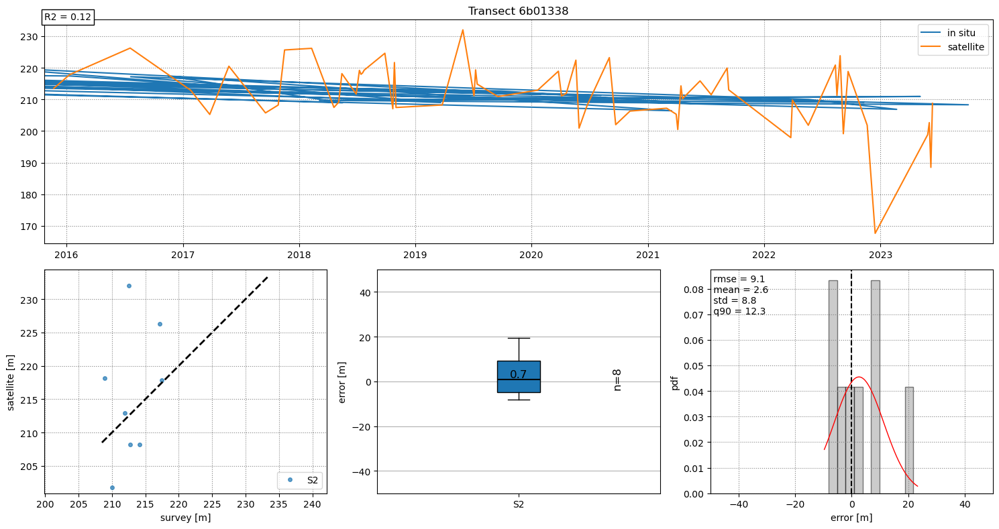

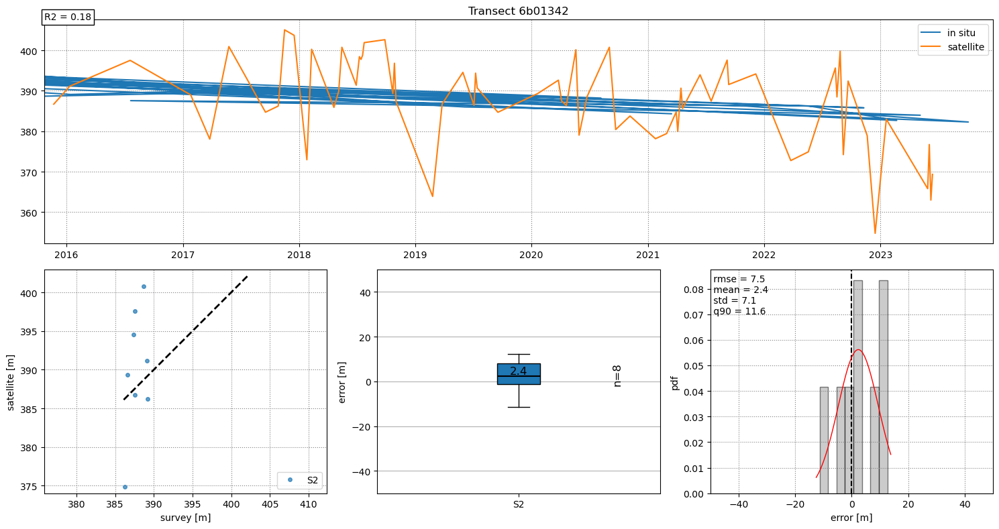

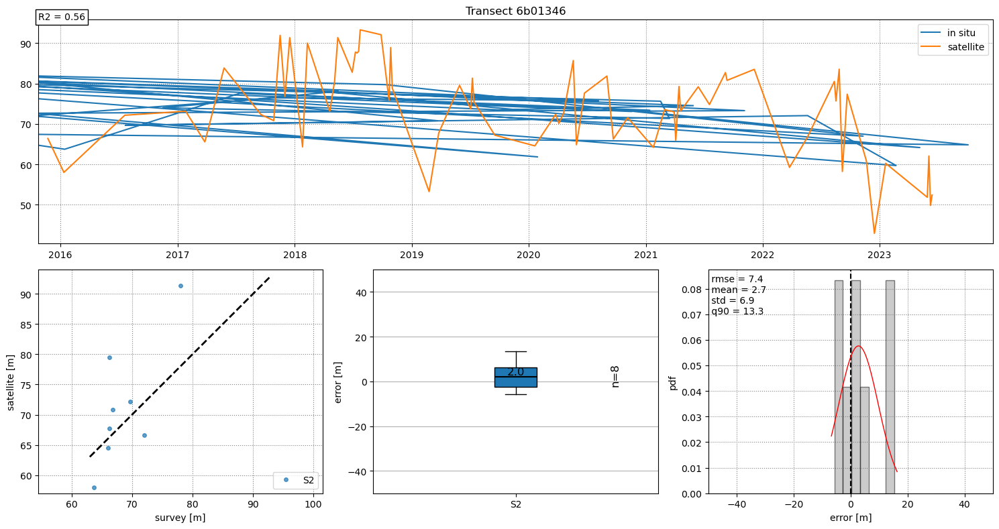

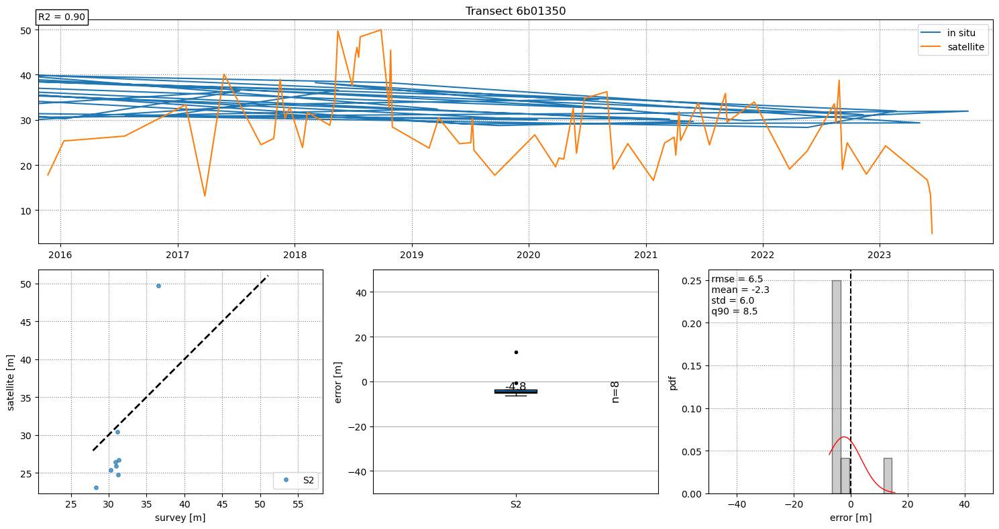

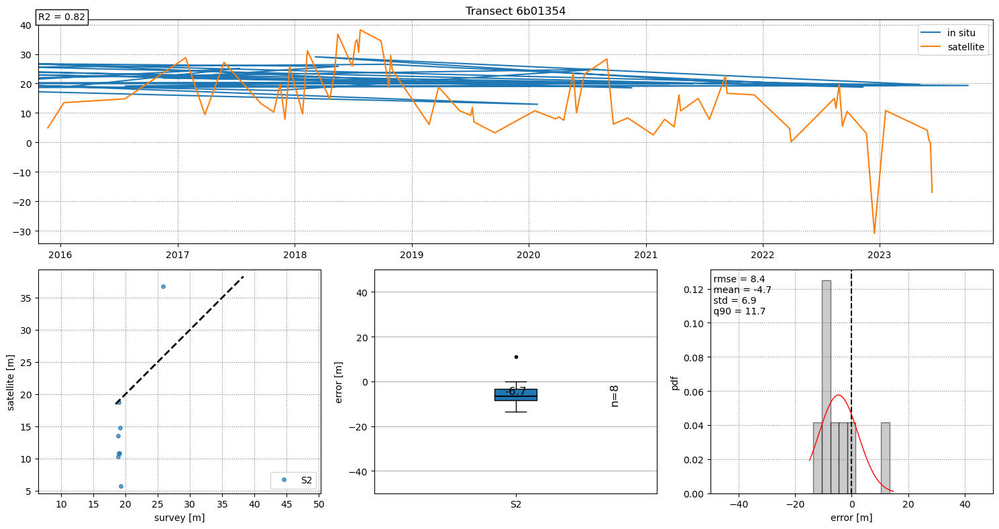

In [33]:
#Helen amended code

%matplotlib inline

# load survey data
with open(os.path.join(os.getcwd(), 'data', 'STARTBAY', 'Startbay_ts_07m.pkl'), 'rb') as f:
    gt = pickle.load(f)
# change names to mach surveys
for i,key in enumerate(list(cross_distance.keys())):
    key_gt = list(gt.keys())[i]
    cross_distance[key_gt] = cross_distance.pop(key)

# set parameters for comparing the two time-series
sett = {'min_days':3,   # numbers of days difference under which to use nearest neighbour interpolation
        'max_days':10,  # maximum number of days difference to do a comparison
        'binwidth':3,   # binwidth for histogram plotting
        'lims':[-50,50] # cross-shore change limits for plotting purposes
       }

# initialise variables
chain_sat_all = []
chain_sur_all = [] 
satnames_all = []  
for key in cross_distance.keys():
    
    # remove nans
    chainage = cross_distance[key]
    idx_nan = np.isnan(chainage)
    dates_nonans = [output['dates'][k] for k in np.where(~idx_nan)[0]]
    satnames_nonans = [output['satname'][k] for k in np.where(~idx_nan)[0]]
    chain_nonans = chainage[~idx_nan]
    
    chain_sat_dm = chain_nonans
    chain_sur_dm = gt[key]['chainages']
    
    # plot the time-series
    fig= plt.figure(figsize=[15,8], tight_layout=True)
    gs = gridspec.GridSpec(2,3)
    ax0 = fig.add_subplot(gs[0,:])
    ax0.grid(which='major',linestyle=':',color='0.5')
    ax0.plot(gt[key]['dates'], chain_sur_dm, '-',mfc='w',ms=5,label='in situ')
    ax0.plot(dates_nonans, chain_sat_dm,'-',mfc='w',ms=5,label='satellite')
    ax0.set(title= 'Transect ' + key, xlim=[output['dates'][0]-timedelta(days=30),
                                           output['dates'][-1]+timedelta(days=30)])#,ylim=sett['lims'])
    ax0.legend()
    
    # interpolate surveyed data around satellite data
    chain_int = np.nan*np.ones(len(dates_nonans))
    for k,date in enumerate(dates_nonans):
        # compute the days distance for each satellite date 
        days_diff = np.array([ (_ - date).days for _ in gt[key]['dates']])
        # if nothing within 10 days put a nan
        if np.min(np.abs(days_diff)) > sett['max_days']:
            chain_int[k] = np.nan
        else:
            # if a point within 3 days, take that point (no interpolation)
            if np.min(np.abs(days_diff)) < sett['min_days']:
                idx_closest = np.where(np.abs(days_diff) == np.min(np.abs(days_diff)))
                chain_int[k] = float(gt[key]['chainages'][idx_closest[0][0]])
            else: # otherwise, between 3 and 10 days, interpolate between the 2 closest points
                if sum(days_diff > 0) == 0:
                    break
                idx_after = np.where(days_diff > 0)[0][0]
                idx_before = idx_after - 1
                x = [gt[key]['dates'][idx_before].toordinal() , gt[key]['dates'][idx_after].toordinal()]
                y = [gt[key]['chainages'][idx_before], gt[key]['chainages'][idx_after]]
                f = interpolate.interp1d(x, y,bounds_error=True)
                chain_int[k] = float(f(date.toordinal()))
    
    # remove nans again
    idx_nan = np.isnan(chain_int)
    chain_sat = chain_nonans[~idx_nan]
    chain_sur = chain_int[~idx_nan]
    dates_sat = [dates_nonans[k] for k in np.where(~idx_nan)[0]]
    satnames = [satnames_nonans[k] for k in np.where(~idx_nan)[0]]
    chain_sat_all = np.append(chain_sat_all,chain_sat)
    chain_sur_all = np.append(chain_sur_all,chain_sur)
    satnames_all = satnames_all + satnames
    
    # error statistics
    slope, intercept, rvalue, pvalue, std_err = stats.linregress(chain_sur, chain_sat)
    R2 = rvalue**2 
    ax0.text(0,1,'R2 = %.2f'%R2,bbox=dict(boxstyle='square', facecolor='w', alpha=1),transform=ax0.transAxes)
    chain_error = chain_sat - chain_sur
    rmse = np.sqrt(np.mean((chain_error)**2))
    mean = np.mean(chain_error)
    std = np.std(chain_error)
    q90 = np.percentile(np.abs(chain_error), 90)
    
    # 1:1 plot
    ax1 = fig.add_subplot(gs[1,0])
    ax1.axis('equal')
    ax1.grid(which='major',linestyle=':',color='0.5')
    for k,sat in enumerate(list(np.unique(satnames))): 
        idx = np.where([_ == sat for _ in satnames])[0]
        ax1.plot(chain_sur[idx], chain_sat[idx], 'o', ms=4, mfc='C'+str(k),mec='C'+str(k), alpha=0.7, label=sat)
    ax1.legend(loc=4)
    ax1.plot([ax1.get_xlim()[0], ax1.get_ylim()[1]],[ax1.get_xlim()[0], ax1.get_ylim()[1]],'k--',lw=2)
    ax1.set(xlabel='survey [m]', ylabel='satellite [m]')

    # boxplots
    ax2 = fig.add_subplot(gs[1,1])
    data = []
    median_data = []
    n_data = []
    ax2.yaxis.grid()
    for k,sat in enumerate(list(np.unique(satnames))):
        idx = np.where([_ == sat for _ in satnames])[0]
        data.append(chain_error[idx])
        median_data.append(np.median(chain_error[idx]))
        n_data.append(len(chain_error[idx]))
    bp = ax2.boxplot(data,0,'k.', labels=list(np.unique(satnames)), patch_artist=True)
    for median in bp['medians']:
        median.set(color='k', linewidth=1.5)
    for j,boxes in enumerate(bp['boxes']):
        boxes.set(facecolor='C'+str(j))
        ax2.text(j+1,median_data[j]+1, '%.1f' % median_data[j], horizontalalignment='center', fontsize=12)
        ax2.text(j+1+0.35,median_data[j]+1, ('n=%.d' % int(n_data[j])), ha='center', va='center', fontsize=12, rotation='vertical')
    ax2.set(ylabel='error [m]', ylim=sett['lims'])
    
    # Histogram
    ax3 = fig.add_subplot(gs[1, 2])
    ax3.grid(which='major', linestyle=':', color='0.5')
    ax3.axvline(x=0, ls='--', lw=1.5, color='k')
    binwidth = sett['binwidth']
    bins = np.arange(min(chain_error), max(chain_error) + binwidth, binwidth)
    density = plt.hist(chain_error, bins=bins, density=True, color='0.6', edgecolor='k', alpha=0.5)
    mu, std = stats.norm.fit(chain_error)
    
    # Perform skewness test only if there are enough samples
    if len(chain_error) >= 8:
        pval = stats.normaltest(chain_error)[1]
    else:
        pval = np.nan
    
    xlims = ax3.get_xlim()
    x = np.linspace(xlims[0], xlims[1], 100)
    p = stats.norm.pdf(x, mu, std)
    ax3.plot(x, p, 'r-', linewidth=1)
    ax3.set(xlabel='error [m]', ylabel='pdf', xlim=sett['lims'])   
    str_stats = ' rmse = %.1f\n mean = %.1f\n std = %.1f\n q90 = %.1f' % (rmse, mean, std, q90) 
    ax3.text(0, 0.98, str_stats, va='top', transform=ax3.transAxes)

    # save plot
    fig.savefig(os.path.join(os.getcwd(),'data', 'STARTBAY','comparison_transect_%s.jpg'%key), dpi=150)

plt.show()

We can also look at the error statistics for all transects:

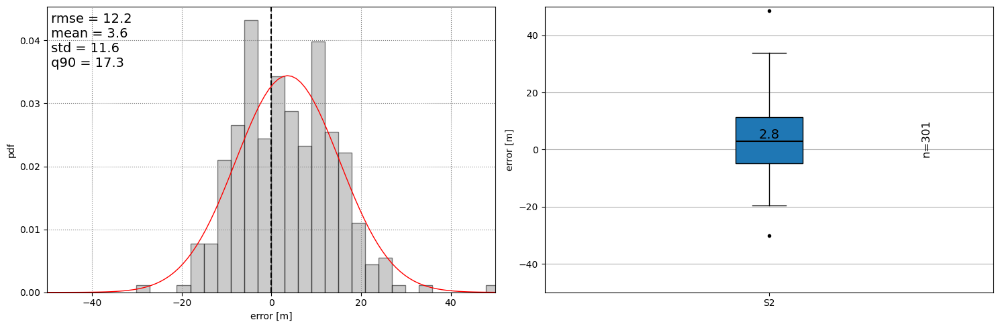

In [34]:
# calculate statistics for all transects together
chain_error = chain_sat_all - chain_sur_all        
slope, intercept, rvalue, pvalue, std_err = stats.linregress(chain_sur, chain_sat) 
R2 = rvalue**2
rmse = np.sqrt(np.mean((chain_error)**2))
mean = np.mean(chain_error)
std = np.std(chain_error)
q90 = np.percentile(np.abs(chain_error), 90)

fig,ax = plt.subplots(1,2,figsize=(15,5), tight_layout=True)
# histogram
ax[0].grid(which='major',linestyle=':',color='0.5')
ax[0].axvline(x=0, ls='--', lw=1.5, color='k')
binwidth=sett['binwidth']
bins = np.arange(min(chain_error), max(chain_error) + binwidth, binwidth)
density = ax[0].hist(chain_error, bins=bins, density=True, color='0.6', edgecolor='k', alpha=0.5)
mu, std = stats.norm.fit(chain_error)
pval = stats.normaltest(chain_error)[1]
xlims = ax3.get_xlim()
x = np.linspace(xlims[0], xlims[1], 100)
p = stats.norm.pdf(x, mu, std)
ax[0].plot(x, p, 'r-', linewidth=1)
ax[0].set(xlabel='error [m]', ylabel='pdf', xlim=sett['lims'])   
str_stats = ' rmse = %.1f\n mean = %.1f\n std = %.1f\n q90 = %.1f' % (rmse, mean, std, q90) 
ax[0].text(0, 0.98, str_stats,va='top', transform=ax[0].transAxes,fontsize=14)

# boxplot
data = []
median_data = []
n_data = []
ax[1].yaxis.grid()
for k,sat in enumerate(list(np.unique(satnames_all))):
    idx = np.where([_ == sat for _ in satnames_all])[0]
    data.append(chain_error[idx])
    median_data.append(np.median(chain_error[idx]))
    n_data.append(len(chain_error[idx]))
bp = ax[1].boxplot(data,0,'k.', labels=list(np.unique(satnames_all)), patch_artist=True)
for median in bp['medians']:
    median.set(color='k', linewidth=1.5)
for j,boxes in enumerate(bp['boxes']):
    boxes.set(facecolor='C'+str(j))
    ax[1].text(j+1,median_data[j]+1, '%.1f' % median_data[j], horizontalalignment='center', fontsize=14)
    ax[1].text(j+1+0.35,median_data[j]+1, ('n=%.d' % int(n_data[j])), ha='center', va='center', fontsize=12, rotation='vertical')
ax[1].set(ylabel='error [m]', ylim=sett['lims']);
fig.savefig(os.path.join(os.getcwd(),'data', 'STARTBAY','comparison_all_transects.jpg'), dpi=150)

%matplotlib inline
plt.show()